In [ ]:
import os
import matplotlib.pyplot as plt
import numpy as np
import torch
from torchvision import transforms
from torch.utils.data import Dataset
from PIL import Image
from glob import glob


In [1]:
from google.colab import drive


ModuleNotFoundError: No module named 'google.colab'

In [2]:
!cd /content/drive/MyDrive

In [3]:
from google.colab import drive
drive.mount('/content/drive',force_remount=True)
%cd /content/drive/MyDrive/Super_Resolution_DL2020/Python/

Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).
/content/drive/MyDrive/Super_Resolution_DL2020/Python


In [1]:

def create_transforms():
    train_transforms = transforms.Compose([
        transforms.Resize((256, 256)),
        transforms.ToTensor(),
    ])
    test_transforms = transforms.Compose([
        transforms.Resize((256, 256)),
        transforms.ToTensor(),
    ])
    return train_transforms, test_transforms


In [5]:
class ChestCTScanDataset(Dataset):
    def __init__(self, data_root, transformations, is_training_set=True):
        # Define the subdirectory based on whether it's training or testing data
        directory = 'train/' if is_training_set else 'test/'
        self.path = os.path.join(data_root, directory)

        # Define the classes (or types of images) in your dataset
        self.classes = ['Adenocarcinoma', 'Large cell carcinoma', 'Squamous cell carcinoma', 'Normal']
        self.input_paths = []

        # Load all images from each class
        for cls in self.classes:
            class_path = os.path.join(self.path, cls)
            print(class_path)
            self.input_paths.extend(glob(os.path.join(class_path, '*')))
        print("Number of images found:", len(self.input_paths))
        self.transformations = transformations

    def __getitem__(self, index):
        # Get the path of the specific image
        img_path = self.input_paths[index]

        # Open the image
        img = Image.open(img_path).convert('RGB')


        # Apply transformations if any
        if self.transformations:
            img = self.transformations(img)

        # In this case, the image is both the input and the label
        sample = {'image': np.array(img), 'label': np.array(img)}

        return sample

    def __len__(self):
        # Return the total number of images in the dataset
        return len(self.input_paths)


/content/drive/MyDrive/CTScan_dataset/Data/train/Adenocarcinoma
/content/drive/MyDrive/CTScan_dataset/Data/train/Large cell carcinoma
/content/drive/MyDrive/CTScan_dataset/Data/train/Squamous cell carcinoma
/content/drive/MyDrive/CTScan_dataset/Data/train/Normal
Number of images found: 418
/content/drive/MyDrive/CTScan_dataset/Data/test/Adenocarcinoma
/content/drive/MyDrive/CTScan_dataset/Data/test/Large cell carcinoma
/content/drive/MyDrive/CTScan_dataset/Data/test/Squamous cell carcinoma
/content/drive/MyDrive/CTScan_dataset/Data/test/Normal
Number of images found: 195
Training example
<class '__main__.ChestCTScanDataset'>


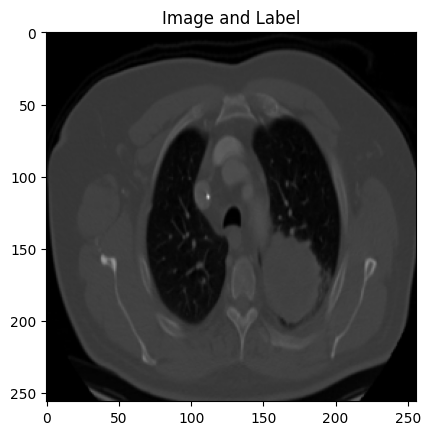

Test example


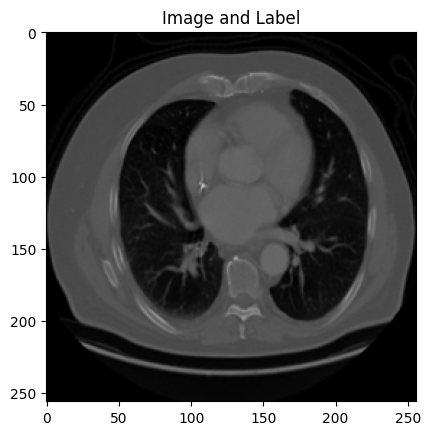

In [6]:
import matplotlib.pyplot as plt
import numpy as np

DATA_ROOT = '/content/drive/MyDrive/CTScan_dataset/Data'

# Assuming the create_transforms function returns appropriate transformations for your dataset
train_transforms, test_transforms = create_transforms()

# Initialize your dataset
train_dataset = ChestCTScanDataset(DATA_ROOT, train_transforms)
test_dataset = ChestCTScanDataset(DATA_ROOT, test_transforms,is_training_set=False)

def visualize_sample(sample):
    image, label = sample['image'], sample['label']

    # Assuming image is a numpy array, transpose it from (C, H, W) to (H, W, C) for visualization
    if isinstance(image, np.ndarray) and image.ndim == 3 and image.shape[0] == 3:
        image = np.transpose(image, (1, 2, 0))

    # Normalize the image for matplotlib if needed
    if image.min() < 0 or image.max() > 1:
        image = (image - image.min()) / (image.max() - image.min())

    plt.imshow(image)
    plt.title("Image and Label")
    plt.show()


# Visualize a training example
print('Training example')
print(type(train_dataset))
visualize_sample(train_dataset[0])

# Visualize a test example
print('Test example')
visualize_sample(test_dataset[0])



In [7]:
!pwd

/content/drive/MyDrive/Super_Resolution_DL2020/Python


In [7]:
%cd /content/drive/MyDrive/Super_Resolution_DL2020/Python

/content/drive/MyDrive/Super_Resolution_DL2020/Python


In [9]:
#from classical_cv.cv2_resizer import Cv2ResizerEvaluation

#Cv2ResizerEvaluation().evaluate_dataset(train_dataset)

/content/drive/MyDrive/CTScan_dataset/Data/train/Adenocarcinoma
/content/drive/MyDrive/CTScan_dataset/Data/train/Large cell carcinoma
/content/drive/MyDrive/CTScan_dataset/Data/train/Squamous cell carcinoma
/content/drive/MyDrive/CTScan_dataset/Data/train/Normal
Number of images found: 418
/content/drive/MyDrive/CTScan_dataset/Data/test/Adenocarcinoma
/content/drive/MyDrive/CTScan_dataset/Data/test/Large cell carcinoma
/content/drive/MyDrive/CTScan_dataset/Data/test/Squamous cell carcinoma
/content/drive/MyDrive/CTScan_dataset/Data/test/Normal
Number of images found: 195


/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 20 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also 

Learning rate : 0.001



  0%|          | 0/27 [00:00<?, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


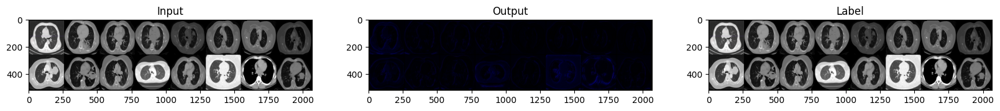


  4%|▎         | 1/27 [00:15<06:54, 15.94s/it]

Train Epoch: 0 [0/418 (0%)]	Loss: 22.943460


 41%|████      | 11/27 [00:29<00:23,  1.45s/it]

Train Epoch: 0 [20/418 (37%)]	Loss: 4.612656


 78%|███████▊  | 21/27 [00:42<00:08,  1.34s/it]

Train Epoch: 0 [40/418 (74%)]	Loss: 2.939312


100%|██████████| 27/27 [00:49<00:00,  1.84s/it]


Mean loss on trainset: 176.7483755350113



  0%|          | 0/195 [00:00<?, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


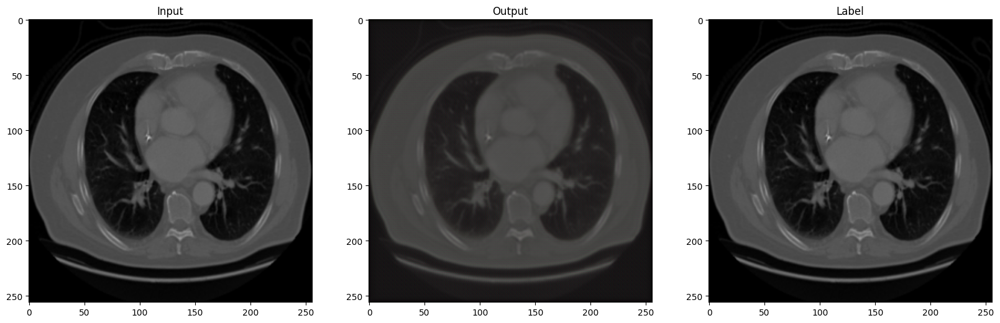


  1%|          | 1/195 [00:00<02:38,  1.22it/s]

Test Epoch: 0 [0/195 (0%)]	Loss: 4.705816


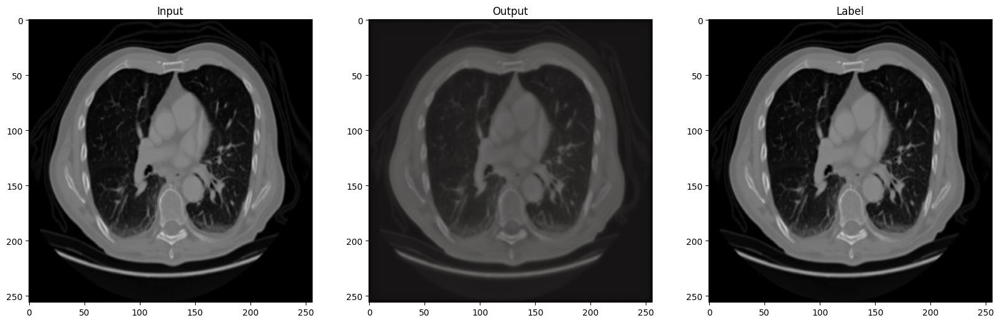


  1%|          | 2/195 [00:01<03:09,  1.02it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


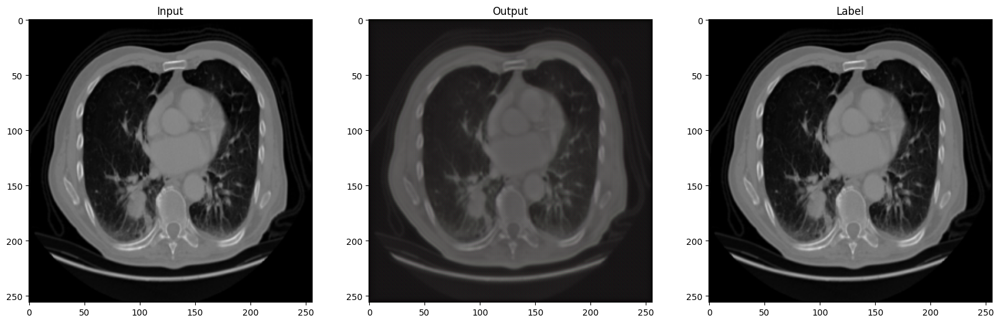

  6%|▌         | 12/195 [00:05<00:40,  4.49it/s]

Test Epoch: 0 [20/195 (5%)]	Loss: 4.547953


 11%|█▏        | 22/195 [00:07<00:31,  5.45it/s]

Test Epoch: 0 [40/195 (10%)]	Loss: 5.394589


 16%|█▋        | 32/195 [00:08<00:29,  5.50it/s]

Test Epoch: 0 [60/195 (15%)]	Loss: 5.167518


 22%|██▏       | 42/195 [00:10<00:31,  4.91it/s]

Test Epoch: 0 [80/195 (21%)]	Loss: 4.905029


 27%|██▋       | 52/195 [00:12<00:26,  5.37it/s]

Test Epoch: 0 [100/195 (26%)]	Loss: 5.668274


 32%|███▏      | 62/195 [00:14<00:24,  5.37it/s]

Test Epoch: 0 [120/195 (31%)]	Loss: 4.681164


 37%|███▋      | 72/195 [00:16<00:25,  4.78it/s]

Test Epoch: 0 [140/195 (36%)]	Loss: 4.643969


 42%|████▏     | 81/195 [00:18<00:23,  4.79it/s]

Test Epoch: 0 [160/195 (41%)]	Loss: 4.851789


 47%|████▋     | 91/195 [00:20<00:21,  4.78it/s]

Test Epoch: 0 [180/195 (46%)]	Loss: 5.115761


 52%|█████▏    | 102/195 [00:22<00:17,  5.44it/s]

Test Epoch: 0 [200/195 (51%)]	Loss: 4.516510


 57%|█████▋    | 111/195 [00:24<00:17,  4.68it/s]

Test Epoch: 0 [220/195 (56%)]	Loss: 4.692316


 63%|██████▎   | 122/195 [00:26<00:15,  4.70it/s]

Test Epoch: 0 [240/195 (62%)]	Loss: 4.769230


 68%|██████▊   | 132/195 [00:28<00:11,  5.67it/s]

Test Epoch: 0 [260/195 (67%)]	Loss: 4.578159


 73%|███████▎  | 142/195 [00:29<00:09,  5.66it/s]

Test Epoch: 0 [280/195 (72%)]	Loss: 5.625835


 78%|███████▊  | 152/195 [00:31<00:08,  4.90it/s]

Test Epoch: 0 [300/195 (77%)]	Loss: 14.226620


 83%|████████▎ | 161/195 [00:33<00:07,  4.78it/s]

Test Epoch: 0 [320/195 (82%)]	Loss: 13.807773


 88%|████████▊ | 172/195 [00:35<00:04,  5.32it/s]

Test Epoch: 0 [340/195 (87%)]	Loss: 11.373101


 93%|█████████▎| 182/195 [00:37<00:02,  5.61it/s]

Test Epoch: 0 [360/195 (92%)]	Loss: 8.160656


 98%|█████████▊| 192/195 [00:39<00:00,  5.77it/s]

Test Epoch: 0 [380/195 (97%)]	Loss: 16.208153


100%|██████████| 195/195 [00:39<00:00,  4.89it/s]


Test loss: 1316.45654296875
Saving best model at /content/drive/MyDrive/Super_Resolution_DL2020/Python/checkpoints/checkpoints_22112023_191747_best.pth
Saving current model at /content/drive/MyDrive/Super_Resolution_DL2020/Python/checkpoints/checkpoints_22112023_191747_current.pth
Learning rate : 0.001



  0%|          | 0/27 [00:00<?, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


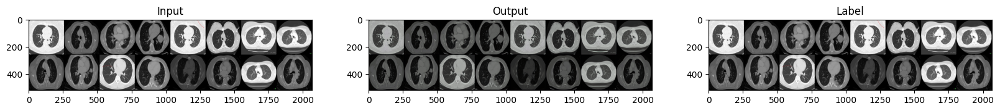


  4%|▎         | 1/27 [00:04<02:00,  4.64s/it]

Train Epoch: 1 [0/418 (0%)]	Loss: 2.249371


 41%|████      | 11/27 [00:18<00:22,  1.40s/it]

Train Epoch: 1 [20/418 (37%)]	Loss: 1.410622


 78%|███████▊  | 21/27 [00:32<00:08,  1.40s/it]

Train Epoch: 1 [40/418 (74%)]	Loss: 1.662755


100%|██████████| 27/27 [00:39<00:00,  1.48s/it]


Mean loss on trainset: 40.41315472126007



  0%|          | 0/195 [00:00<?, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


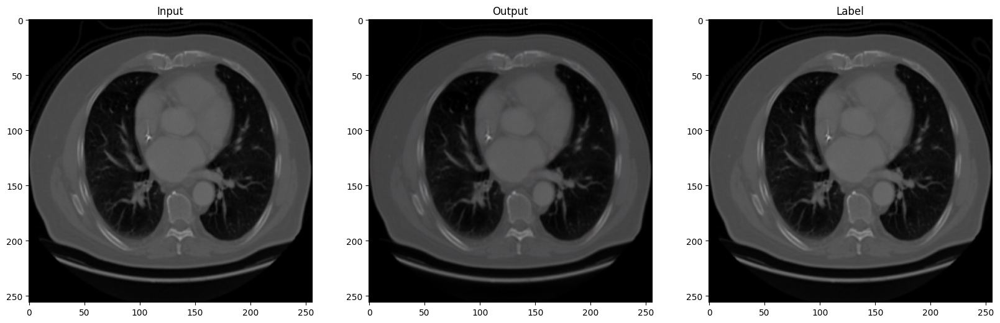


  1%|          | 1/195 [00:00<02:32,  1.27it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Test Epoch: 1 [0/195 (0%)]	Loss: 0.782799


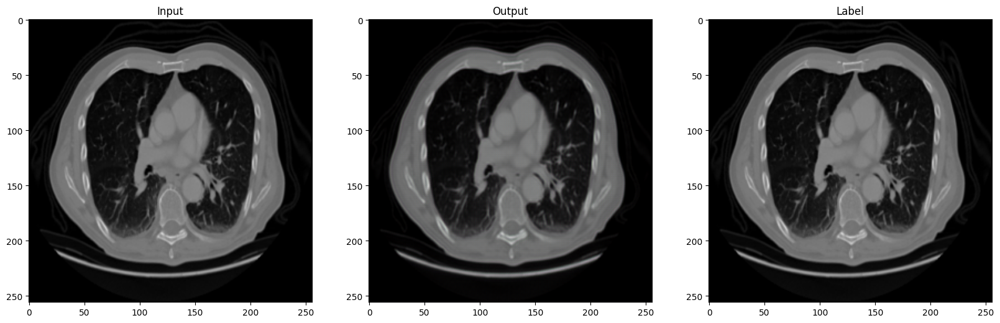


  1%|          | 2/195 [00:01<02:35,  1.25it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


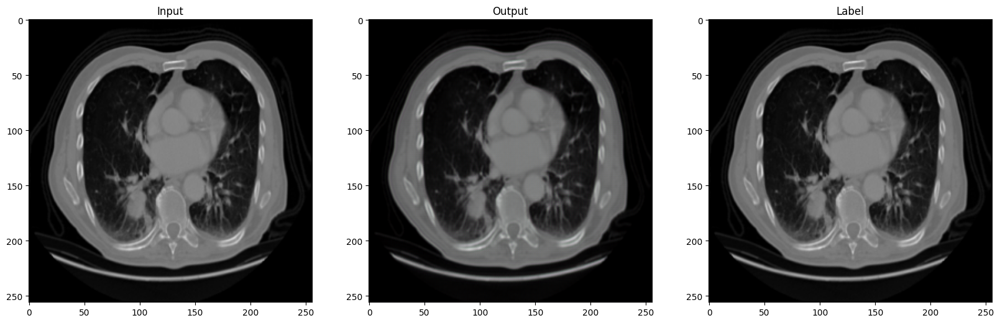

  8%|▊         | 15/195 [00:03<00:16, 10.76it/s]

Test Epoch: 1 [20/195 (5%)]	Loss: 0.691638


 12%|█▏        | 24/195 [00:03<00:09, 17.62it/s]

Test Epoch: 1 [40/195 (10%)]	Loss: 0.818952


 18%|█▊        | 36/195 [00:03<00:07, 22.21it/s]

Test Epoch: 1 [60/195 (15%)]	Loss: 0.740725


 23%|██▎       | 45/195 [00:04<00:06, 23.56it/s]

Test Epoch: 1 [80/195 (21%)]	Loss: 0.765357


 28%|██▊       | 54/195 [00:04<00:05, 24.26it/s]

Test Epoch: 1 [100/195 (26%)]	Loss: 0.871497


 34%|███▍      | 66/195 [00:05<00:05, 24.27it/s]

Test Epoch: 1 [120/195 (31%)]	Loss: 0.781841


 38%|███▊      | 75/195 [00:05<00:05, 23.83it/s]

Test Epoch: 1 [140/195 (36%)]	Loss: 0.772324


 43%|████▎     | 84/195 [00:05<00:04, 24.51it/s]

Test Epoch: 1 [160/195 (41%)]	Loss: 0.807606


 49%|████▉     | 96/195 [00:06<00:04, 23.97it/s]

Test Epoch: 1 [180/195 (46%)]	Loss: 0.733743


 54%|█████▍    | 105/195 [00:06<00:03, 24.36it/s]

Test Epoch: 1 [200/195 (51%)]	Loss: 0.580376


 58%|█████▊    | 114/195 [00:07<00:03, 24.47it/s]

Test Epoch: 1 [220/195 (56%)]	Loss: 0.759772


 65%|██████▍   | 126/195 [00:07<00:02, 24.16it/s]

Test Epoch: 1 [240/195 (62%)]	Loss: 0.634093


 69%|██████▉   | 135/195 [00:08<00:02, 24.20it/s]

Test Epoch: 1 [260/195 (67%)]	Loss: 0.668918


 74%|███████▍  | 144/195 [00:08<00:02, 23.26it/s]

Test Epoch: 1 [280/195 (72%)]	Loss: 0.868201


 78%|███████▊  | 153/195 [00:08<00:02, 20.04it/s]

Test Epoch: 1 [300/195 (77%)]	Loss: 3.029992


 85%|████████▍ | 165/195 [00:09<00:01, 21.93it/s]

Test Epoch: 1 [320/195 (82%)]	Loss: 3.101675


 89%|████████▉ | 174/195 [00:09<00:01, 20.71it/s]

Test Epoch: 1 [340/195 (87%)]	Loss: 2.318645


 94%|█████████▍| 183/195 [00:10<00:00, 20.68it/s]

Test Epoch: 1 [360/195 (92%)]	Loss: 1.258590


100%|██████████| 195/195 [00:10<00:00, 17.96it/s]

Test Epoch: 1 [380/195 (97%)]	Loss: 3.028457
Test loss: 238.89993286132812
Saving best model at /content/drive/MyDrive/Super_Resolution_DL2020/Python/checkpoints/checkpoints_22112023_191747_best.pth


Saving current model at /content/drive/MyDrive/Super_Resolution_DL2020/Python/checkpoints/checkpoints_22112023_191747_current.pth
Learning rate : 0.001



  0%|          | 0/27 [00:00<?, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


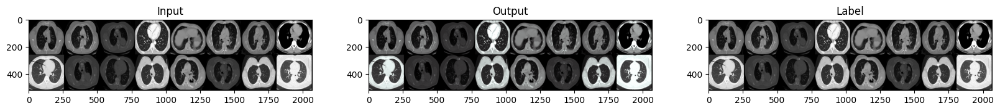


  4%|▎         | 1/27 [00:04<01:51,  4.30s/it]

Train Epoch: 2 [0/418 (0%)]	Loss: 1.085007


 41%|████      | 11/27 [00:17<00:22,  1.40s/it]

Train Epoch: 2 [20/418 (37%)]	Loss: 0.980026


 78%|███████▊  | 21/27 [00:31<00:08,  1.38s/it]

Train Epoch: 2 [40/418 (74%)]	Loss: 0.954208


100%|██████████| 27/27 [00:39<00:00,  1.46s/it]


Mean loss on trainset: 26.76922571659088



  0%|          | 0/195 [00:00<?, ?it/s]

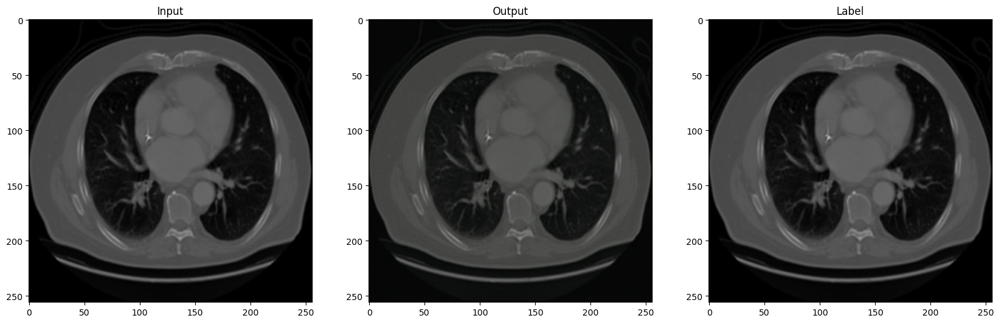


  1%|          | 1/195 [00:00<02:36,  1.24it/s]

Test Epoch: 2 [0/195 (0%)]	Loss: 0.465914


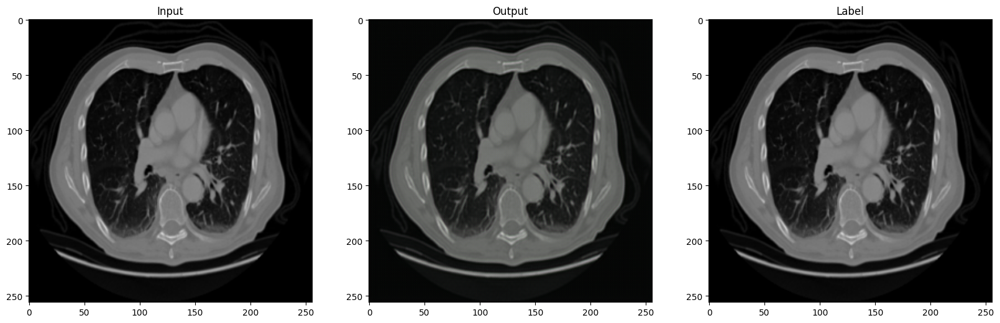


  1%|          | 2/195 [00:01<03:03,  1.05it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


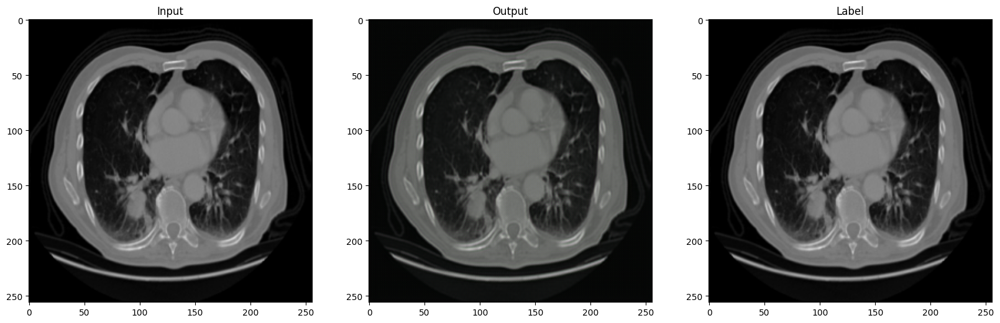

  8%|▊         | 15/195 [00:03<00:17, 10.34it/s]

Test Epoch: 2 [20/195 (5%)]	Loss: 0.433850


 13%|█▎        | 25/195 [00:03<00:09, 17.89it/s]

Test Epoch: 2 [40/195 (10%)]	Loss: 0.556111


 17%|█▋        | 34/195 [00:04<00:07, 21.28it/s]

Test Epoch: 2 [60/195 (15%)]	Loss: 0.437167


 24%|██▎       | 46/195 [00:04<00:06, 23.94it/s]

Test Epoch: 2 [80/195 (21%)]	Loss: 0.479437


 28%|██▊       | 55/195 [00:04<00:05, 24.47it/s]

Test Epoch: 2 [100/195 (26%)]	Loss: 0.562733


 33%|███▎      | 65/195 [00:05<00:05, 24.50it/s]

Test Epoch: 2 [120/195 (31%)]	Loss: 0.469090


 38%|███▊      | 74/195 [00:05<00:04, 24.78it/s]

Test Epoch: 2 [140/195 (36%)]	Loss: 0.444815


 44%|████▍     | 86/195 [00:06<00:04, 24.67it/s]

Test Epoch: 2 [160/195 (41%)]	Loss: 0.468108


 49%|████▊     | 95/195 [00:06<00:04, 24.58it/s]

Test Epoch: 2 [180/195 (46%)]	Loss: 0.517109


 53%|█████▎    | 104/195 [00:06<00:03, 24.51it/s]

Test Epoch: 2 [200/195 (51%)]	Loss: 0.439515


 59%|█████▉    | 116/195 [00:07<00:03, 24.56it/s]

Test Epoch: 2 [220/195 (56%)]	Loss: 0.488761


 64%|██████▍   | 125/195 [00:07<00:02, 24.71it/s]

Test Epoch: 2 [240/195 (62%)]	Loss: 0.442342


 69%|██████▉   | 135/195 [00:08<00:02, 24.83it/s]

Test Epoch: 2 [260/195 (67%)]	Loss: 0.430216


 74%|███████▍  | 144/195 [00:08<00:02, 24.18it/s]

Test Epoch: 2 [280/195 (72%)]	Loss: 0.575791


 80%|████████  | 156/195 [00:09<00:01, 23.33it/s]

Test Epoch: 2 [300/195 (77%)]	Loss: 1.600435


 85%|████████▍ | 165/195 [00:09<00:01, 22.23it/s]

Test Epoch: 2 [320/195 (82%)]	Loss: 1.613826


 89%|████████▉ | 174/195 [00:09<00:00, 21.44it/s]

Test Epoch: 2 [340/195 (87%)]	Loss: 0.676194


 94%|█████████▍| 183/195 [00:10<00:00, 20.88it/s]

Test Epoch: 2 [360/195 (92%)]	Loss: 0.588078


100%|██████████| 195/195 [00:10<00:00, 17.77it/s]

Test Epoch: 2 [380/195 (97%)]	Loss: 1.404288
Test loss: 138.48048400878906
Saving best model at /content/drive/MyDrive/Super_Resolution_DL2020/Python/checkpoints/checkpoints_22112023_191747_best.pth


Saving current model at /content/drive/MyDrive/Super_Resolution_DL2020/Python/checkpoints/checkpoints_22112023_191747_current.pth
Learning rate : 0.001



  0%|          | 0/27 [00:00<?, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


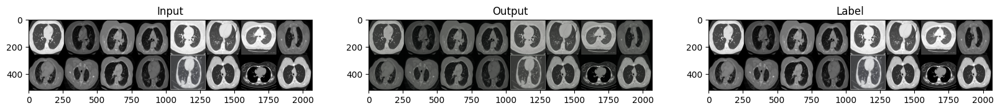


  4%|▎         | 1/27 [00:05<02:21,  5.45s/it]

Train Epoch: 3 [0/418 (0%)]	Loss: 0.963909


 41%|████      | 11/27 [00:19<00:22,  1.41s/it]

Train Epoch: 3 [20/418 (37%)]	Loss: 0.756004


 78%|███████▊  | 21/27 [00:32<00:08,  1.39s/it]

Train Epoch: 3 [40/418 (74%)]	Loss: 0.598208


100%|██████████| 27/27 [00:41<00:00,  1.52s/it]


Mean loss on trainset: 21.46037846803665



  0%|          | 0/195 [00:00<?, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


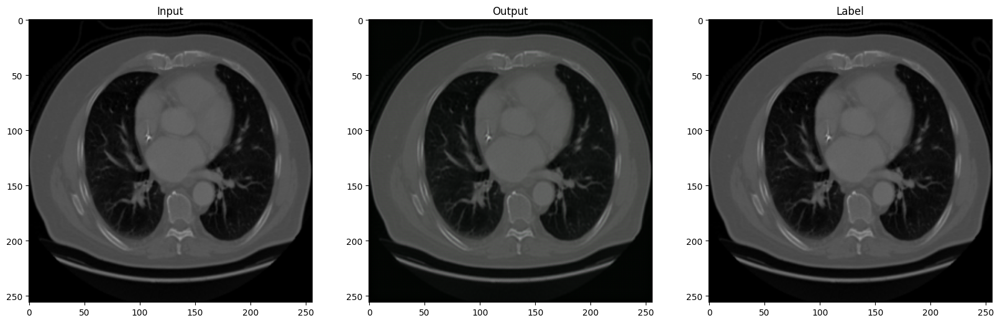


  1%|          | 1/195 [00:00<02:52,  1.12it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Test Epoch: 3 [0/195 (0%)]	Loss: 0.386299


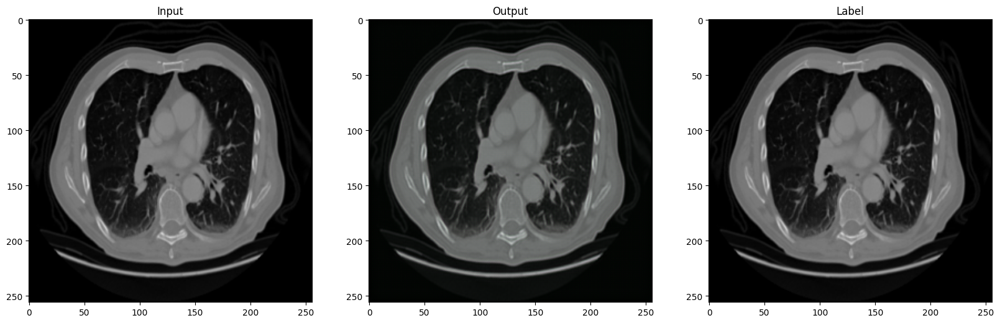


  1%|          | 2/195 [00:01<02:59,  1.08it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


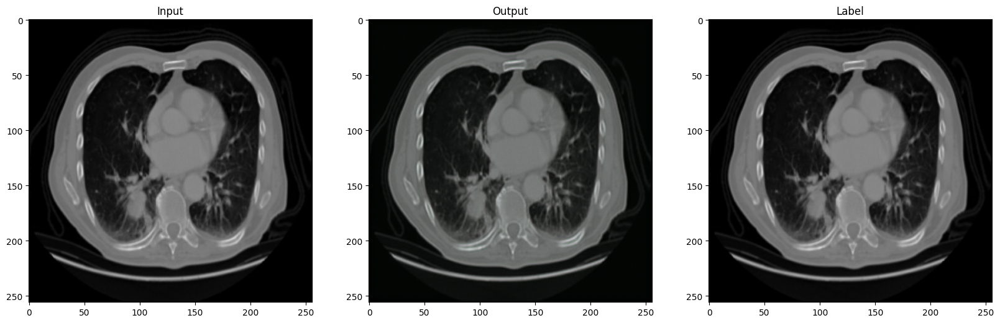

  7%|▋         | 14/195 [00:03<00:19,  9.48it/s]

Test Epoch: 3 [20/195 (5%)]	Loss: 0.358807


 13%|█▎        | 26/195 [00:03<00:09, 18.64it/s]

Test Epoch: 3 [40/195 (10%)]	Loss: 0.501536


 18%|█▊        | 35/195 [00:04<00:07, 22.12it/s]

Test Epoch: 3 [60/195 (15%)]	Loss: 0.327431


 23%|██▎       | 44/195 [00:04<00:06, 23.60it/s]

Test Epoch: 3 [80/195 (21%)]	Loss: 0.402694


 29%|██▊       | 56/195 [00:05<00:05, 24.11it/s]

Test Epoch: 3 [100/195 (26%)]	Loss: 0.505516


 33%|███▎      | 65/195 [00:05<00:05, 24.28it/s]

Test Epoch: 3 [120/195 (31%)]	Loss: 0.416837


 38%|███▊      | 74/195 [00:05<00:04, 24.84it/s]

Test Epoch: 3 [140/195 (36%)]	Loss: 0.390335


 44%|████▍     | 86/195 [00:06<00:04, 24.57it/s]

Test Epoch: 3 [160/195 (41%)]	Loss: 0.409062


 49%|████▊     | 95/195 [00:06<00:04, 24.48it/s]

Test Epoch: 3 [180/195 (46%)]	Loss: 0.460473


 53%|█████▎    | 104/195 [00:06<00:03, 24.41it/s]

Test Epoch: 3 [200/195 (51%)]	Loss: 0.395499


 59%|█████▉    | 116/195 [00:07<00:03, 24.30it/s]

Test Epoch: 3 [220/195 (56%)]	Loss: 0.426338


 64%|██████▍   | 125/195 [00:07<00:02, 24.58it/s]

Test Epoch: 3 [240/195 (62%)]	Loss: 0.368290


 69%|██████▊   | 134/195 [00:08<00:02, 24.80it/s]

Test Epoch: 3 [260/195 (67%)]	Loss: 0.387884


 73%|███████▎  | 143/195 [00:08<00:02, 24.11it/s]

Test Epoch: 3 [280/195 (72%)]	Loss: 0.491056


 79%|███████▉  | 155/195 [00:09<00:01, 23.24it/s]

Test Epoch: 3 [300/195 (77%)]	Loss: 1.528448


 84%|████████▍ | 164/195 [00:09<00:01, 23.33it/s]

Test Epoch: 3 [320/195 (82%)]	Loss: 1.513424


 89%|████████▊ | 173/195 [00:09<00:00, 22.74it/s]

Test Epoch: 3 [340/195 (87%)]	Loss: 0.978029


 95%|█████████▍| 185/195 [00:10<00:00, 22.22it/s]

Test Epoch: 3 [360/195 (92%)]	Loss: 0.649239


100%|██████████| 195/195 [00:10<00:00, 17.91it/s]

Test Epoch: 3 [380/195 (97%)]	Loss: 1.428854
Test loss: 125.65892028808594
Saving best model at /content/drive/MyDrive/Super_Resolution_DL2020/Python/checkpoints/checkpoints_22112023_191747_best.pth


Saving current model at /content/drive/MyDrive/Super_Resolution_DL2020/Python/checkpoints/checkpoints_22112023_191747_current.pth
Learning rate : 0.001



  0%|          | 0/27 [00:00<?, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


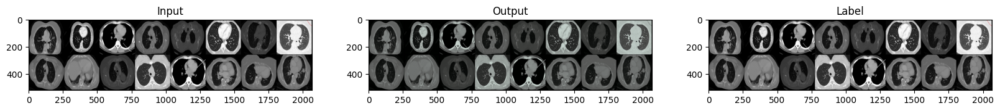


  4%|▎         | 1/27 [00:06<02:54,  6.72s/it]

Train Epoch: 4 [0/418 (0%)]	Loss: 0.786059


 41%|████      | 11/27 [00:20<00:22,  1.42s/it]

Train Epoch: 4 [20/418 (37%)]	Loss: 0.620381


 78%|███████▊  | 21/27 [00:34<00:08,  1.39s/it]

Train Epoch: 4 [40/418 (74%)]	Loss: 0.697486


100%|██████████| 27/27 [00:42<00:00,  1.57s/it]


Mean loss on trainset: 19.467211425304413



  0%|          | 0/195 [00:00<?, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


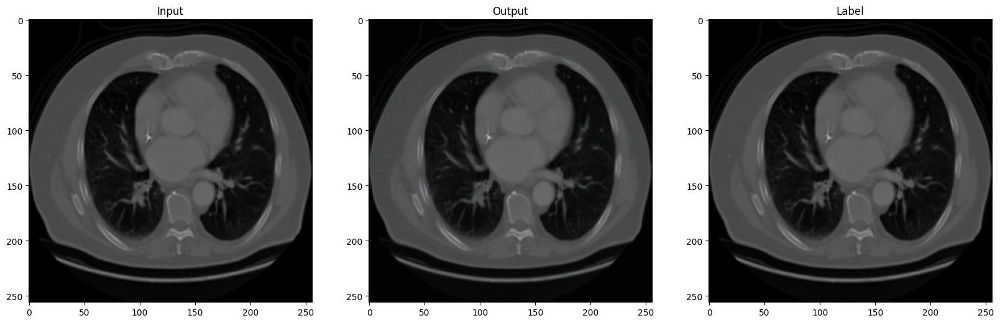


  1%|          | 1/195 [00:01<03:48,  1.18s/it]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Test Epoch: 4 [0/195 (0%)]	Loss: 0.289267


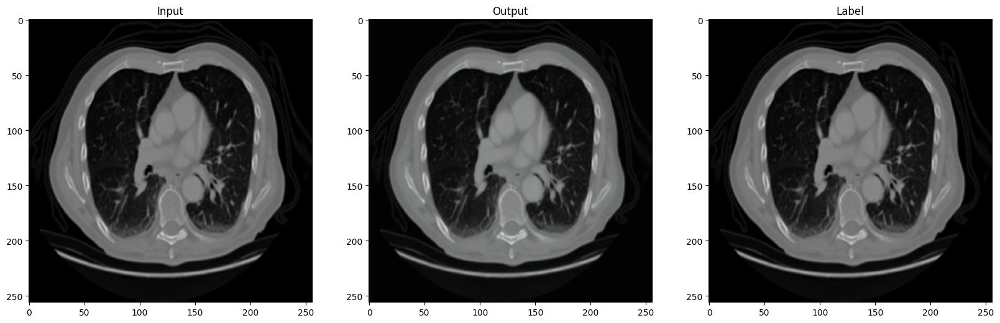


  1%|          | 2/195 [00:02<03:42,  1.15s/it]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


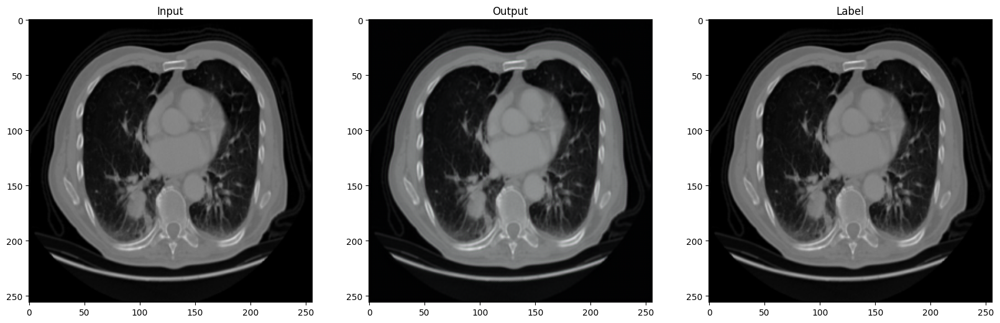

  7%|▋         | 14/195 [00:03<00:21,  8.29it/s]

Test Epoch: 4 [20/195 (5%)]	Loss: 0.298547


 13%|█▎        | 26/195 [00:04<00:09, 17.78it/s]

Test Epoch: 4 [40/195 (10%)]	Loss: 0.384290


 18%|█▊        | 35/195 [00:04<00:07, 21.42it/s]

Test Epoch: 4 [60/195 (15%)]	Loss: 0.231400


 23%|██▎       | 44/195 [00:05<00:06, 23.56it/s]

Test Epoch: 4 [80/195 (21%)]	Loss: 0.318809


 29%|██▊       | 56/195 [00:05<00:05, 24.28it/s]

Test Epoch: 4 [100/195 (26%)]	Loss: 0.376610


 33%|███▎      | 65/195 [00:06<00:05, 24.36it/s]

Test Epoch: 4 [120/195 (31%)]	Loss: 0.342041


 38%|███▊      | 74/195 [00:06<00:04, 24.65it/s]

Test Epoch: 4 [140/195 (36%)]	Loss: 0.321186


 44%|████▍     | 86/195 [00:06<00:04, 24.66it/s]

Test Epoch: 4 [160/195 (41%)]	Loss: 0.307913


 49%|████▊     | 95/195 [00:07<00:04, 24.42it/s]

Test Epoch: 4 [180/195 (46%)]	Loss: 0.322359


 53%|█████▎    | 104/195 [00:07<00:03, 24.64it/s]

Test Epoch: 4 [200/195 (51%)]	Loss: 0.306817


 59%|█████▉    | 116/195 [00:08<00:03, 24.36it/s]

Test Epoch: 4 [220/195 (56%)]	Loss: 0.344790


 64%|██████▍   | 125/195 [00:08<00:02, 24.35it/s]

Test Epoch: 4 [240/195 (62%)]	Loss: 0.290748


 69%|██████▊   | 134/195 [00:08<00:02, 24.58it/s]

Test Epoch: 4 [260/195 (67%)]	Loss: 0.295349


 73%|███████▎  | 143/195 [00:09<00:02, 23.42it/s]

Test Epoch: 4 [280/195 (72%)]	Loss: 0.355809


 79%|███████▉  | 155/195 [00:09<00:01, 23.44it/s]

Test Epoch: 4 [300/195 (77%)]	Loss: 1.252903


 84%|████████▍ | 164/195 [00:10<00:01, 23.39it/s]

Test Epoch: 4 [320/195 (82%)]	Loss: 1.297400


 90%|█████████ | 176/195 [00:10<00:00, 23.90it/s]

Test Epoch: 4 [340/195 (87%)]	Loss: 0.912964


 95%|█████████▍| 185/195 [00:11<00:00, 22.53it/s]

Test Epoch: 4 [360/195 (92%)]	Loss: 0.410293


100%|██████████| 195/195 [00:11<00:00, 16.92it/s]

Test Epoch: 4 [380/195 (97%)]	Loss: 1.566103
Test loss: 99.04708862304688
Saving best model at /content/drive/MyDrive/Super_Resolution_DL2020/Python/checkpoints/checkpoints_22112023_191747_best.pth


Saving current model at /content/drive/MyDrive/Super_Resolution_DL2020/Python/checkpoints/checkpoints_22112023_191747_current.pth
Learning rate : 0.001



  0%|          | 0/27 [00:00<?, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


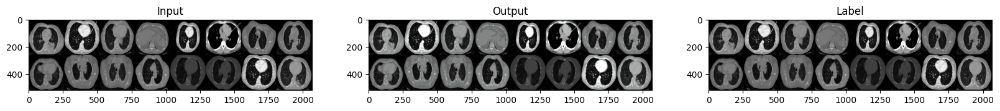


  4%|▎         | 1/27 [00:06<02:39,  6.12s/it]

Train Epoch: 5 [0/418 (0%)]	Loss: 0.529766


 41%|████      | 11/27 [00:19<00:22,  1.42s/it]

Train Epoch: 5 [20/418 (37%)]	Loss: 0.514928


 78%|███████▊  | 21/27 [00:33<00:08,  1.39s/it]

Train Epoch: 5 [40/418 (74%)]	Loss: 0.684490


100%|██████████| 27/27 [00:41<00:00,  1.54s/it]


Mean loss on trainset: 20.237613260746002



  0%|          | 0/195 [00:00<?, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


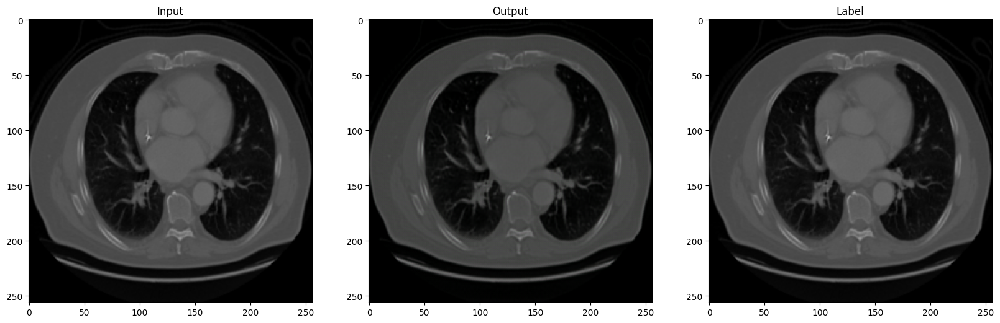


  1%|          | 1/195 [00:00<03:09,  1.02it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Test Epoch: 5 [0/195 (0%)]	Loss: 0.554102


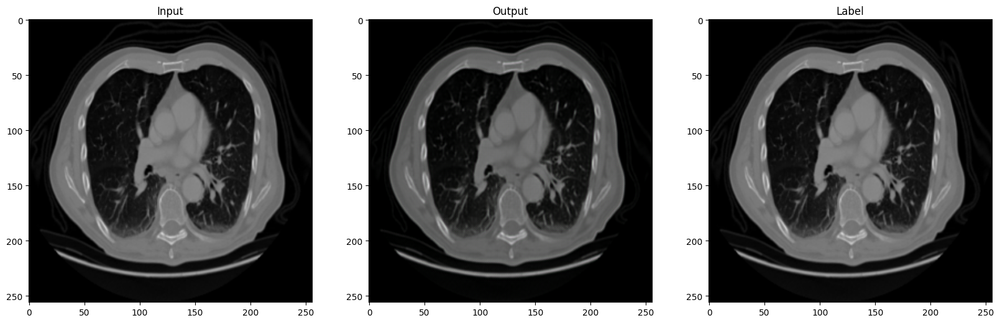


  1%|          | 2/195 [00:01<03:06,  1.04it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


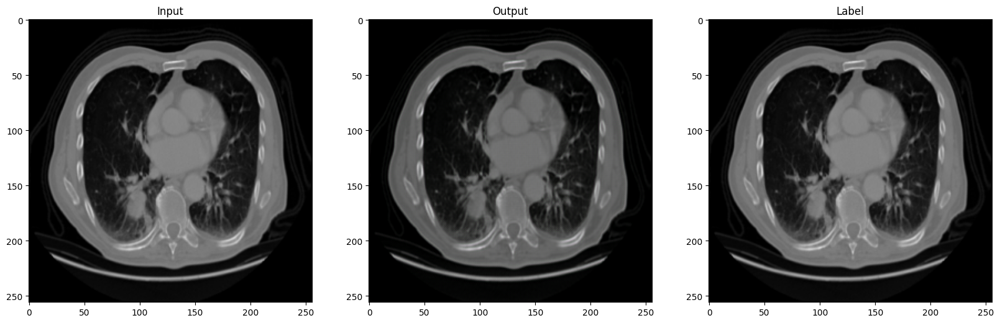

  7%|▋         | 14/195 [00:03<00:19,  9.28it/s]

Test Epoch: 5 [20/195 (5%)]	Loss: 0.457186


 13%|█▎        | 26/195 [00:03<00:08, 18.79it/s]

Test Epoch: 5 [40/195 (10%)]	Loss: 0.452500


 18%|█▊        | 35/195 [00:04<00:07, 22.12it/s]

Test Epoch: 5 [60/195 (15%)]	Loss: 0.402070


 23%|██▎       | 44/195 [00:04<00:06, 23.82it/s]

Test Epoch: 5 [80/195 (21%)]	Loss: 0.507333


 29%|██▊       | 56/195 [00:05<00:05, 24.23it/s]

Test Epoch: 5 [100/195 (26%)]	Loss: 0.499341


 33%|███▎      | 65/195 [00:05<00:05, 24.49it/s]

Test Epoch: 5 [120/195 (31%)]	Loss: 0.514946


 38%|███▊      | 75/195 [00:05<00:04, 24.69it/s]

Test Epoch: 5 [140/195 (36%)]	Loss: 0.495352


 43%|████▎     | 84/195 [00:06<00:04, 24.86it/s]

Test Epoch: 5 [160/195 (41%)]	Loss: 0.464992


 49%|████▉     | 96/195 [00:06<00:04, 24.52it/s]

Test Epoch: 5 [180/195 (46%)]	Loss: 0.433971


 54%|█████▍    | 105/195 [00:07<00:03, 24.62it/s]

Test Epoch: 5 [200/195 (51%)]	Loss: 0.351022


 58%|█████▊    | 114/195 [00:07<00:03, 24.52it/s]

Test Epoch: 5 [220/195 (56%)]	Loss: 0.502299


 65%|██████▍   | 126/195 [00:07<00:02, 24.57it/s]

Test Epoch: 5 [240/195 (62%)]	Loss: 0.415607


 69%|██████▉   | 135/195 [00:08<00:02, 24.65it/s]

Test Epoch: 5 [260/195 (67%)]	Loss: 0.411316


 74%|███████▍  | 144/195 [00:08<00:02, 24.05it/s]

Test Epoch: 5 [280/195 (72%)]	Loss: 0.453642


 80%|████████  | 156/195 [00:09<00:01, 24.06it/s]

Test Epoch: 5 [300/195 (77%)]	Loss: 0.838285


 85%|████████▍ | 165/195 [00:09<00:01, 23.75it/s]

Test Epoch: 5 [320/195 (82%)]	Loss: 0.889558


 89%|████████▉ | 174/195 [00:09<00:00, 24.06it/s]

Test Epoch: 5 [340/195 (87%)]	Loss: 0.361266


 94%|█████████▍| 183/195 [00:10<00:00, 22.17it/s]

Test Epoch: 5 [360/195 (92%)]	Loss: 0.337332


100%|██████████| 195/195 [00:10<00:00, 17.85it/s]

Test Epoch: 5 [380/195 (97%)]	Loss: 0.719662
Test loss: 103.02462005615234
Saving current model at /content/drive/MyDrive/Super_Resolution_DL2020/Python/checkpoints/checkpoints_22112023_191747_current.pth


Learning rate : 0.001



  0%|          | 0/27 [00:00<?, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


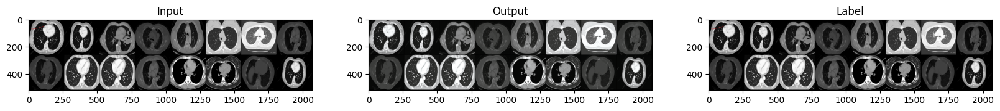


  4%|▎         | 1/27 [00:07<03:25,  7.91s/it]

Train Epoch: 6 [0/418 (0%)]	Loss: 0.670860


 41%|████      | 11/27 [00:21<00:22,  1.43s/it]

Train Epoch: 6 [20/418 (37%)]	Loss: 0.477123


 78%|███████▊  | 21/27 [00:35<00:08,  1.39s/it]

Train Epoch: 6 [40/418 (74%)]	Loss: 0.421499


100%|██████████| 27/27 [00:43<00:00,  1.62s/it]


Mean loss on trainset: 15.53840509057045



  0%|          | 0/195 [00:00<?, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


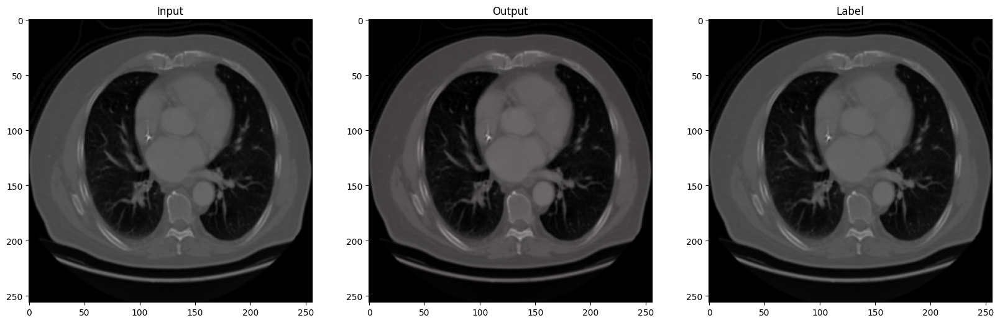


  1%|          | 1/195 [00:01<03:22,  1.04s/it]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Test Epoch: 6 [0/195 (0%)]	Loss: 0.287580


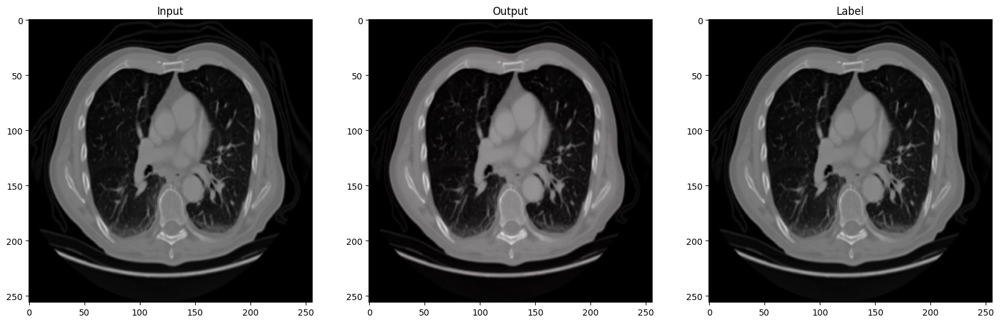


  1%|          | 2/195 [00:02<03:37,  1.13s/it]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


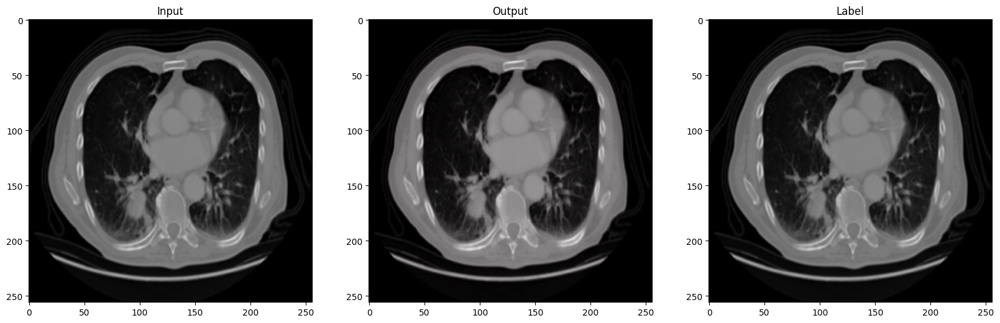

  7%|▋         | 14/195 [00:03<00:20,  8.71it/s]

Test Epoch: 6 [20/195 (5%)]	Loss: 0.320789


 13%|█▎        | 26/195 [00:04<00:09, 18.29it/s]

Test Epoch: 6 [40/195 (10%)]	Loss: 0.448571


 18%|█▊        | 35/195 [00:04<00:07, 21.60it/s]

Test Epoch: 6 [60/195 (15%)]	Loss: 0.222321


 23%|██▎       | 44/195 [00:05<00:06, 23.65it/s]

Test Epoch: 6 [80/195 (21%)]	Loss: 0.328407


 29%|██▊       | 56/195 [00:05<00:05, 23.65it/s]

Test Epoch: 6 [100/195 (26%)]	Loss: 0.533074


 33%|███▎      | 65/195 [00:05<00:05, 24.44it/s]

Test Epoch: 6 [120/195 (31%)]	Loss: 0.352994


 38%|███▊      | 74/195 [00:06<00:04, 24.46it/s]

Test Epoch: 6 [140/195 (36%)]	Loss: 0.347343


 44%|████▍     | 86/195 [00:06<00:04, 24.02it/s]

Test Epoch: 6 [160/195 (41%)]	Loss: 0.336206


 49%|████▊     | 95/195 [00:07<00:04, 24.34it/s]

Test Epoch: 6 [180/195 (46%)]	Loss: 0.457848


 53%|█████▎    | 104/195 [00:07<00:03, 24.42it/s]

Test Epoch: 6 [200/195 (51%)]	Loss: 0.399841


 59%|█████▉    | 116/195 [00:07<00:03, 24.47it/s]

Test Epoch: 6 [220/195 (56%)]	Loss: 0.357303


 64%|██████▍   | 125/195 [00:08<00:02, 24.41it/s]

Test Epoch: 6 [240/195 (62%)]	Loss: 0.349469


 69%|██████▊   | 134/195 [00:08<00:02, 24.71it/s]

Test Epoch: 6 [260/195 (67%)]	Loss: 0.317515


 75%|███████▍  | 146/195 [00:09<00:02, 23.67it/s]

Test Epoch: 6 [280/195 (72%)]	Loss: 0.431440


 79%|███████▉  | 155/195 [00:09<00:01, 23.12it/s]

Test Epoch: 6 [300/195 (77%)]	Loss: 2.194234


 84%|████████▍ | 164/195 [00:09<00:01, 23.45it/s]

Test Epoch: 6 [320/195 (82%)]	Loss: 2.028093


 90%|█████████ | 176/195 [00:10<00:00, 23.78it/s]

Test Epoch: 6 [340/195 (87%)]	Loss: 1.839912


 95%|█████████▍| 185/195 [00:10<00:00, 23.22it/s]

Test Epoch: 6 [360/195 (92%)]	Loss: 0.952768


100%|██████████| 195/195 [00:11<00:00, 17.23it/s]

Test Epoch: 6 [380/195 (97%)]	Loss: 2.484096
Test loss: 138.0064697265625
Saving current model at /content/drive/MyDrive/Super_Resolution_DL2020/Python/checkpoints/checkpoints_22112023_191747_current.pth


Learning rate : 0.001



  0%|          | 0/27 [00:00<?, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


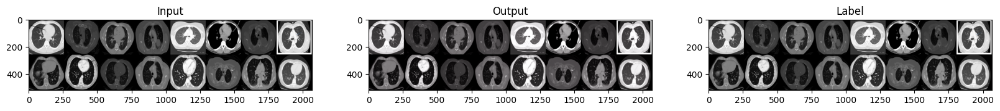


  4%|▎         | 1/27 [00:07<03:20,  7.72s/it]

Train Epoch: 7 [0/418 (0%)]	Loss: 0.649694


 41%|████      | 11/27 [00:21<00:22,  1.43s/it]

Train Epoch: 7 [20/418 (37%)]	Loss: 0.568093


 78%|███████▊  | 21/27 [00:35<00:08,  1.39s/it]

Train Epoch: 7 [40/418 (74%)]	Loss: 0.695579


100%|██████████| 27/27 [00:43<00:00,  1.60s/it]


Mean loss on trainset: 17.93314664065838



  0%|          | 0/195 [00:00<?, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


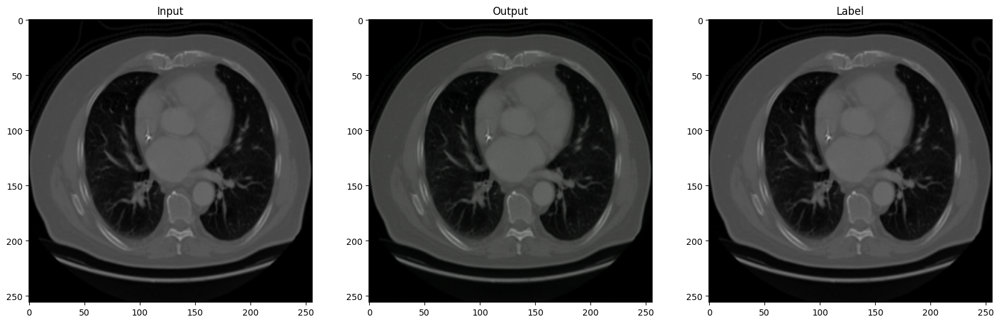


  1%|          | 1/195 [00:01<03:51,  1.19s/it]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Test Epoch: 7 [0/195 (0%)]	Loss: 0.230369


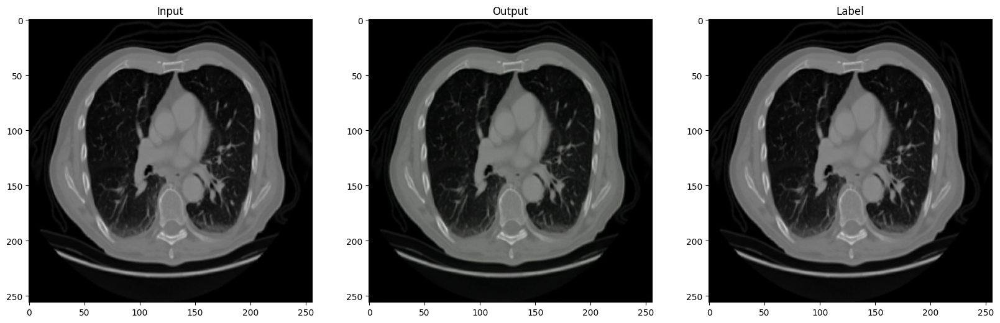


  1%|          | 2/195 [00:02<03:27,  1.07s/it]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


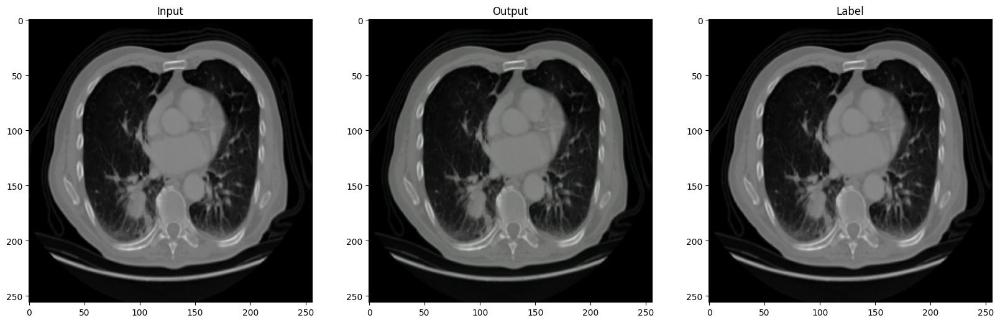

  7%|▋         | 14/195 [00:03<00:21,  8.44it/s]

Test Epoch: 7 [20/195 (5%)]	Loss: 0.204763


 13%|█▎        | 26/195 [00:04<00:09, 18.12it/s]

Test Epoch: 7 [40/195 (10%)]	Loss: 0.201269


 18%|█▊        | 35/195 [00:04<00:07, 21.86it/s]

Test Epoch: 7 [60/195 (15%)]	Loss: 0.219233


 23%|██▎       | 44/195 [00:05<00:06, 23.69it/s]

Test Epoch: 7 [80/195 (21%)]	Loss: 0.219462


 29%|██▊       | 56/195 [00:05<00:05, 23.56it/s]

Test Epoch: 7 [100/195 (26%)]	Loss: 0.243928


 33%|███▎      | 65/195 [00:05<00:05, 24.42it/s]

Test Epoch: 7 [120/195 (31%)]	Loss: 0.215599


 38%|███▊      | 74/195 [00:06<00:04, 24.69it/s]

Test Epoch: 7 [140/195 (36%)]	Loss: 0.241066


 44%|████▍     | 86/195 [00:06<00:04, 24.13it/s]

Test Epoch: 7 [160/195 (41%)]	Loss: 0.218721


 49%|████▊     | 95/195 [00:07<00:04, 24.44it/s]

Test Epoch: 7 [180/195 (46%)]	Loss: 0.209735


 53%|█████▎    | 104/195 [00:07<00:03, 24.71it/s]

Test Epoch: 7 [200/195 (51%)]	Loss: 0.179595


 59%|█████▉    | 116/195 [00:07<00:03, 24.14it/s]

Test Epoch: 7 [220/195 (56%)]	Loss: 0.211512


 64%|██████▍   | 125/195 [00:08<00:02, 24.48it/s]

Test Epoch: 7 [240/195 (62%)]	Loss: 0.197162


 69%|██████▊   | 134/195 [00:08<00:02, 24.54it/s]

Test Epoch: 7 [260/195 (67%)]	Loss: 0.184431


 73%|███████▎  | 143/195 [00:09<00:02, 23.57it/s]

Test Epoch: 7 [280/195 (72%)]	Loss: 0.209235


 79%|███████▉  | 155/195 [00:09<00:01, 22.61it/s]

Test Epoch: 7 [300/195 (77%)]	Loss: 0.645076


 84%|████████▍ | 164/195 [00:10<00:01, 22.85it/s]

Test Epoch: 7 [320/195 (82%)]	Loss: 0.833463


 90%|█████████ | 176/195 [00:10<00:00, 22.30it/s]

Test Epoch: 7 [340/195 (87%)]	Loss: 0.460536


 95%|█████████▍| 185/195 [00:11<00:00, 21.15it/s]

Test Epoch: 7 [360/195 (92%)]	Loss: 0.238853


100%|██████████| 195/195 [00:11<00:00, 16.92it/s]

Test Epoch: 7 [380/195 (97%)]	Loss: 1.321370
Test loss: 61.332000732421875
Saving best model at /content/drive/MyDrive/Super_Resolution_DL2020/Python/checkpoints/checkpoints_22112023_191747_best.pth


Saving current model at /content/drive/MyDrive/Super_Resolution_DL2020/Python/checkpoints/checkpoints_22112023_191747_current.pth
Learning rate : 0.001



  0%|          | 0/27 [00:00<?, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


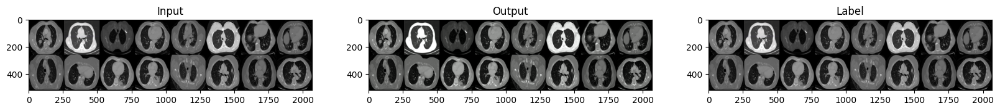


  4%|▎         | 1/27 [00:07<03:12,  7.39s/it]

Train Epoch: 8 [0/418 (0%)]	Loss: 0.541922


 41%|████      | 11/27 [00:21<00:22,  1.43s/it]

Train Epoch: 8 [20/418 (37%)]	Loss: 0.490022


 78%|███████▊  | 21/27 [00:35<00:08,  1.39s/it]

Train Epoch: 8 [40/418 (74%)]	Loss: 0.257045


100%|██████████| 27/27 [00:42<00:00,  1.59s/it]


Mean loss on trainset: 16.57358530163765



  0%|          | 0/195 [00:00<?, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


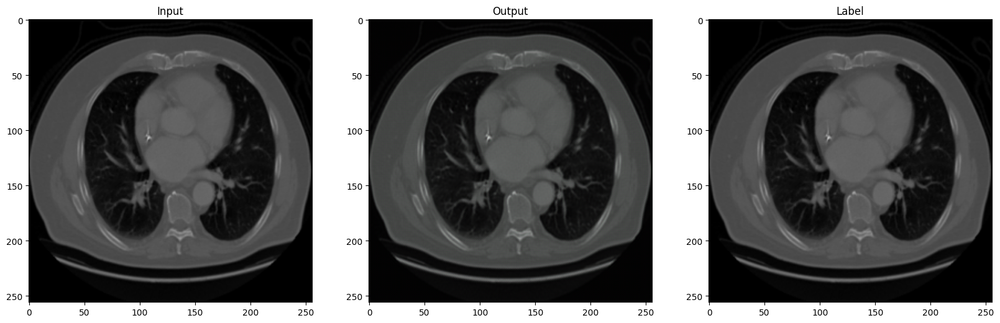


  1%|          | 1/195 [00:01<03:22,  1.05s/it]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Test Epoch: 8 [0/195 (0%)]	Loss: 0.165612


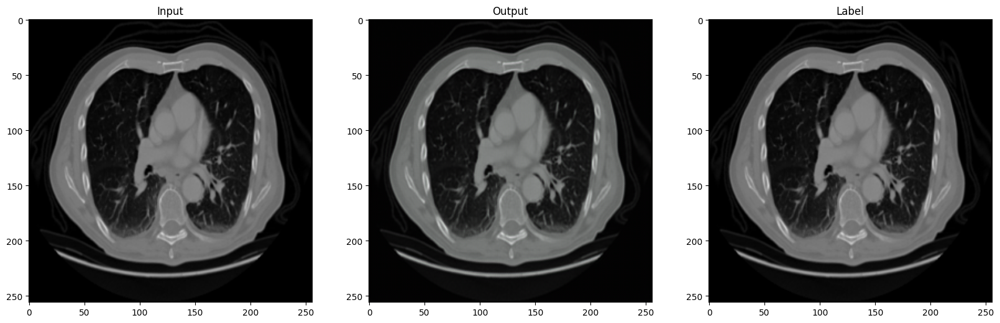


  1%|          | 2/195 [00:02<03:17,  1.02s/it]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


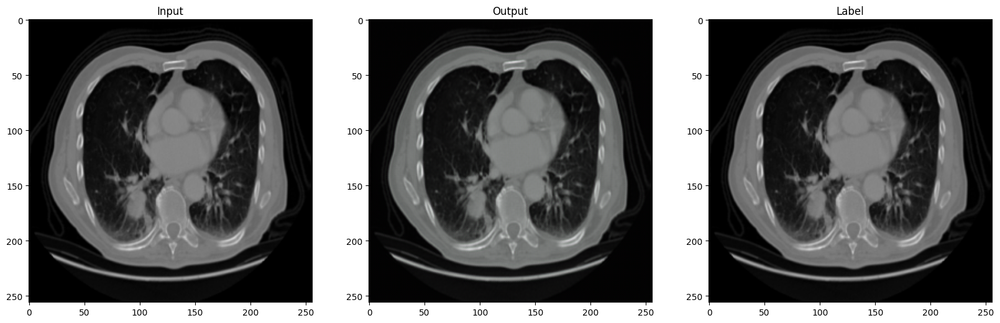

  8%|▊         | 15/195 [00:03<00:18,  9.77it/s]

Test Epoch: 8 [20/195 (5%)]	Loss: 0.157246


 12%|█▏        | 24/195 [00:03<00:10, 16.82it/s]

Test Epoch: 8 [40/195 (10%)]	Loss: 0.175019


 18%|█▊        | 36/195 [00:04<00:07, 22.12it/s]

Test Epoch: 8 [60/195 (15%)]	Loss: 0.139556


 23%|██▎       | 45/195 [00:04<00:06, 23.69it/s]

Test Epoch: 8 [80/195 (21%)]	Loss: 0.165657


 28%|██▊       | 54/195 [00:05<00:05, 24.51it/s]

Test Epoch: 8 [100/195 (26%)]	Loss: 0.176656


 34%|███▍      | 66/195 [00:05<00:05, 24.51it/s]

Test Epoch: 8 [120/195 (31%)]	Loss: 0.156030


 38%|███▊      | 75/195 [00:06<00:04, 24.26it/s]

Test Epoch: 8 [140/195 (36%)]	Loss: 0.168325


 43%|████▎     | 84/195 [00:06<00:04, 24.70it/s]

Test Epoch: 8 [160/195 (41%)]	Loss: 0.157716


 49%|████▉     | 96/195 [00:06<00:04, 24.51it/s]

Test Epoch: 8 [180/195 (46%)]	Loss: 0.165145


 54%|█████▍    | 105/195 [00:07<00:03, 24.09it/s]

Test Epoch: 8 [200/195 (51%)]	Loss: 0.149104


 58%|█████▊    | 114/195 [00:07<00:03, 24.52it/s]

Test Epoch: 8 [220/195 (56%)]	Loss: 0.163990


 65%|██████▍   | 126/195 [00:08<00:02, 24.11it/s]

Test Epoch: 8 [240/195 (62%)]	Loss: 0.152748


 69%|██████▉   | 135/195 [00:08<00:02, 24.66it/s]

Test Epoch: 8 [260/195 (67%)]	Loss: 0.142235


 74%|███████▍  | 144/195 [00:08<00:02, 24.13it/s]

Test Epoch: 8 [280/195 (72%)]	Loss: 0.169414


 80%|████████  | 156/195 [00:09<00:01, 24.07it/s]

Test Epoch: 8 [300/195 (77%)]	Loss: 0.648457


 85%|████████▍ | 165/195 [00:09<00:01, 23.57it/s]

Test Epoch: 8 [320/195 (82%)]	Loss: 0.687741


 89%|████████▉ | 174/195 [00:10<00:00, 22.81it/s]

Test Epoch: 8 [340/195 (87%)]	Loss: 0.495879


 94%|█████████▍| 183/195 [00:10<00:00, 22.39it/s]

Test Epoch: 8 [360/195 (92%)]	Loss: 0.237438


100%|██████████| 195/195 [00:11<00:00, 17.52it/s]

Test Epoch: 8 [380/195 (97%)]	Loss: 0.713724
Test loss: 51.028038024902344
Saving best model at /content/drive/MyDrive/Super_Resolution_DL2020/Python/checkpoints/checkpoints_22112023_191747_best.pth


Saving current model at /content/drive/MyDrive/Super_Resolution_DL2020/Python/checkpoints/checkpoints_22112023_191747_current.pth
Learning rate : 0.001



  0%|          | 0/27 [00:00<?, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


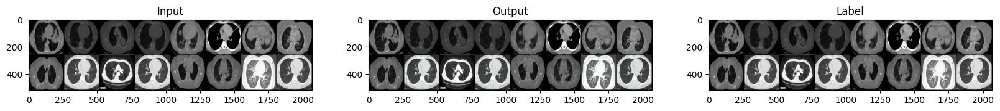


  4%|▎         | 1/27 [00:07<03:23,  7.84s/it]

Train Epoch: 9 [0/418 (0%)]	Loss: 0.336836


 41%|████      | 11/27 [00:21<00:22,  1.43s/it]

Train Epoch: 9 [20/418 (37%)]	Loss: 0.419287


 78%|███████▊  | 21/27 [00:35<00:08,  1.39s/it]

Train Epoch: 9 [40/418 (74%)]	Loss: 0.801490


100%|██████████| 27/27 [00:43<00:00,  1.61s/it]


Mean loss on trainset: 11.494966119527817



  0%|          | 0/195 [00:00<?, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


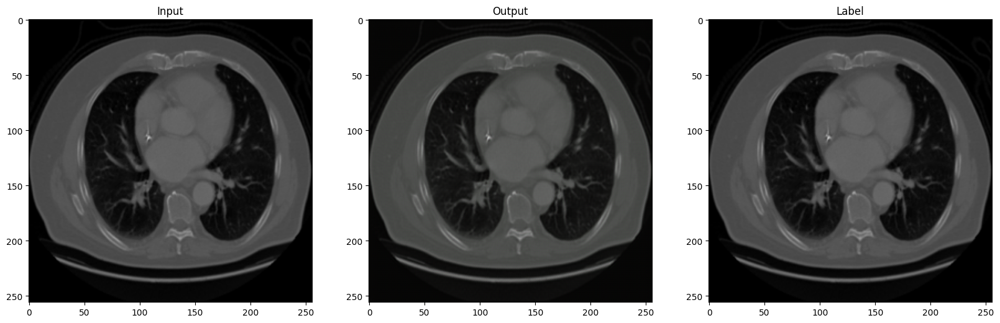


  1%|          | 1/195 [00:01<03:42,  1.15s/it]

Test Epoch: 9 [0/195 (0%)]	Loss: 0.313707


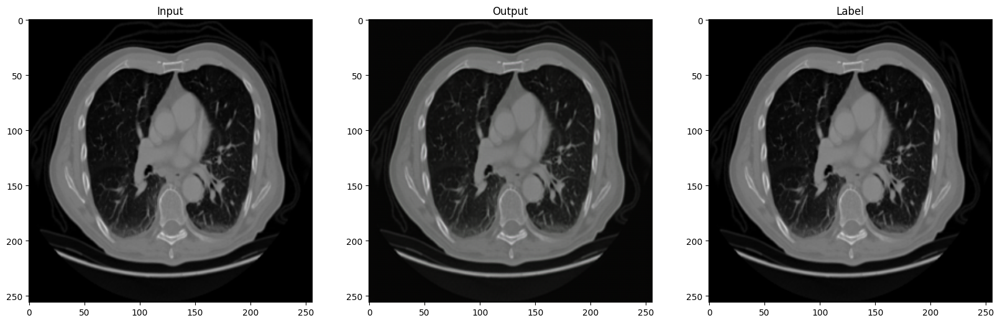


  1%|          | 2/195 [00:02<04:26,  1.38s/it]

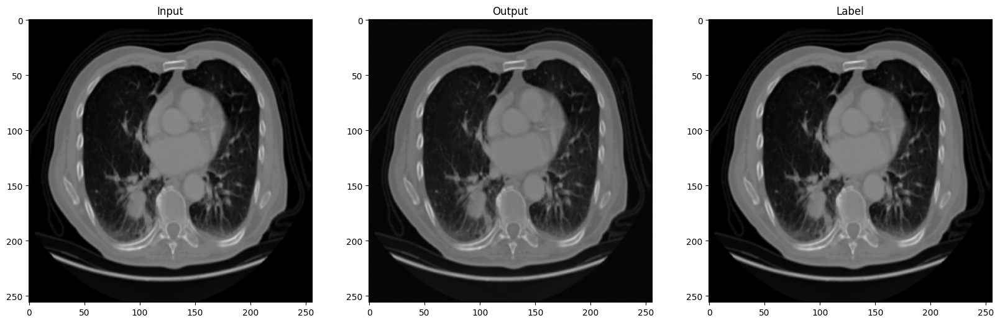

  7%|▋         | 14/195 [00:04<00:22,  7.93it/s]

Test Epoch: 9 [20/195 (5%)]	Loss: 0.239122


 13%|█▎        | 26/195 [00:04<00:09, 17.47it/s]

Test Epoch: 9 [40/195 (10%)]	Loss: 0.277367


 18%|█▊        | 35/195 [00:05<00:07, 21.21it/s]

Test Epoch: 9 [60/195 (15%)]	Loss: 0.241175


 23%|██▎       | 44/195 [00:05<00:06, 23.61it/s]

Test Epoch: 9 [80/195 (21%)]	Loss: 0.255328


 29%|██▊       | 56/195 [00:05<00:05, 24.23it/s]

Test Epoch: 9 [100/195 (26%)]	Loss: 0.274444


 33%|███▎      | 65/195 [00:06<00:05, 24.24it/s]

Test Epoch: 9 [120/195 (31%)]	Loss: 0.231651


 38%|███▊      | 74/195 [00:06<00:04, 24.56it/s]

Test Epoch: 9 [140/195 (36%)]	Loss: 0.265702


 44%|████▍     | 86/195 [00:07<00:04, 24.42it/s]

Test Epoch: 9 [160/195 (41%)]	Loss: 0.235380


 49%|████▊     | 95/195 [00:07<00:04, 24.58it/s]

Test Epoch: 9 [180/195 (46%)]	Loss: 0.261146


 53%|█████▎    | 104/195 [00:07<00:03, 24.80it/s]

Test Epoch: 9 [200/195 (51%)]	Loss: 0.228311


 59%|█████▉    | 116/195 [00:08<00:03, 24.43it/s]

Test Epoch: 9 [220/195 (56%)]	Loss: 0.225881


 64%|██████▍   | 125/195 [00:08<00:02, 24.76it/s]

Test Epoch: 9 [240/195 (62%)]	Loss: 0.221731


 69%|██████▉   | 135/195 [00:09<00:02, 24.83it/s]

Test Epoch: 9 [260/195 (67%)]	Loss: 0.216873


 74%|███████▍  | 144/195 [00:09<00:02, 24.17it/s]

Test Epoch: 9 [280/195 (72%)]	Loss: 0.259586


 80%|████████  | 156/195 [00:10<00:01, 24.16it/s]

Test Epoch: 9 [300/195 (77%)]	Loss: 0.517391


 85%|████████▍ | 165/195 [00:10<00:01, 23.87it/s]

Test Epoch: 9 [320/195 (82%)]	Loss: 0.532789


 89%|████████▉ | 174/195 [00:10<00:00, 23.94it/s]

Test Epoch: 9 [340/195 (87%)]	Loss: 0.306963


 94%|█████████▍| 183/195 [00:11<00:00, 23.17it/s]

Test Epoch: 9 [360/195 (92%)]	Loss: 0.233773


100%|██████████| 195/195 [00:11<00:00, 16.57it/s]

Test Epoch: 9 [380/195 (97%)]	Loss: 0.598197
Test loss: 58.47798156738281
Saving current model at /content/drive/MyDrive/Super_Resolution_DL2020/Python/checkpoints/checkpoints_22112023_191747_current.pth


Learning rate : 0.001



  0%|          | 0/27 [00:00<?, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


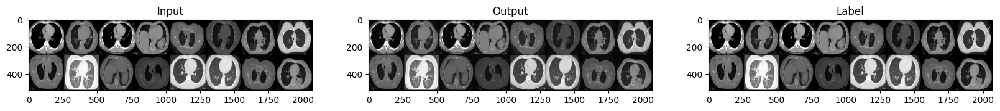


  4%|▎         | 1/27 [00:07<03:12,  7.39s/it]

Train Epoch: 10 [0/418 (0%)]	Loss: 0.332507


 41%|████      | 11/27 [00:21<00:22,  1.42s/it]

Train Epoch: 10 [20/418 (37%)]	Loss: 0.372018


 78%|███████▊  | 21/27 [00:34<00:08,  1.39s/it]

Train Epoch: 10 [40/418 (74%)]	Loss: 0.691355


100%|██████████| 27/27 [00:42<00:00,  1.59s/it]


Mean loss on trainset: 11.44775503873825



  0%|          | 0/195 [00:00<?, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


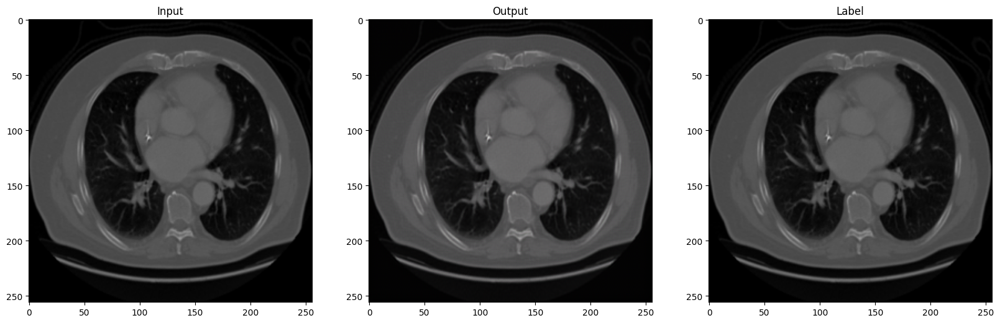


  1%|          | 1/195 [00:01<03:39,  1.13s/it]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Test Epoch: 10 [0/195 (0%)]	Loss: 0.138880


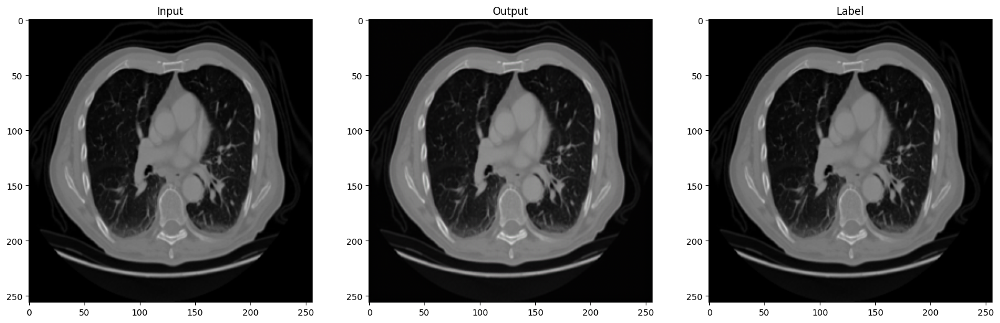


  1%|          | 2/195 [00:02<03:39,  1.14s/it]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


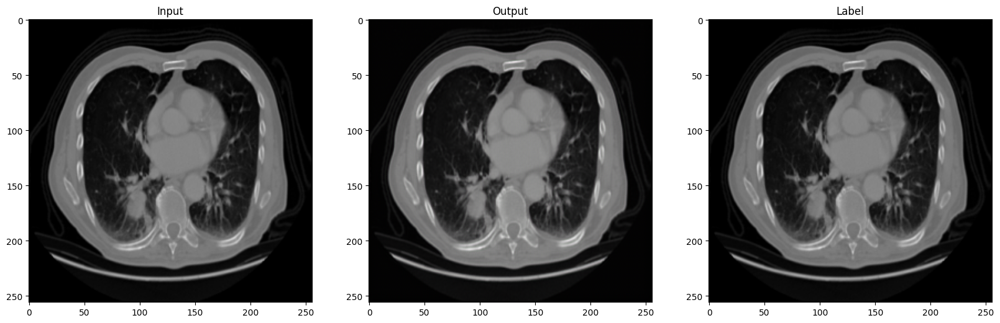

  8%|▊         | 15/195 [00:03<00:19,  9.01it/s]

Test Epoch: 10 [20/195 (5%)]	Loss: 0.119635


 13%|█▎        | 25/195 [00:04<00:10, 16.84it/s]

Test Epoch: 10 [40/195 (10%)]	Loss: 0.178166


 17%|█▋        | 34/195 [00:04<00:07, 21.03it/s]

Test Epoch: 10 [60/195 (15%)]	Loss: 0.111033


 24%|██▎       | 46/195 [00:05<00:06, 23.59it/s]

Test Epoch: 10 [80/195 (21%)]	Loss: 0.124280


 28%|██▊       | 55/195 [00:05<00:05, 24.13it/s]

Test Epoch: 10 [100/195 (26%)]	Loss: 0.181651


 33%|███▎      | 65/195 [00:06<00:05, 24.95it/s]

Test Epoch: 10 [120/195 (31%)]	Loss: 0.128290


 38%|███▊      | 74/195 [00:06<00:04, 24.57it/s]

Test Epoch: 10 [140/195 (36%)]	Loss: 0.121777


 44%|████▍     | 86/195 [00:06<00:04, 23.76it/s]

Test Epoch: 10 [160/195 (41%)]	Loss: 0.121789


 49%|████▊     | 95/195 [00:07<00:04, 24.04it/s]

Test Epoch: 10 [180/195 (46%)]	Loss: 0.168163


 53%|█████▎    | 104/195 [00:07<00:03, 24.43it/s]

Test Epoch: 10 [200/195 (51%)]	Loss: 0.142733


 59%|█████▉    | 116/195 [00:08<00:03, 24.26it/s]

Test Epoch: 10 [220/195 (56%)]	Loss: 0.134145


 64%|██████▍   | 125/195 [00:08<00:02, 24.68it/s]

Test Epoch: 10 [240/195 (62%)]	Loss: 0.123402


 69%|██████▉   | 135/195 [00:08<00:02, 24.87it/s]

Test Epoch: 10 [260/195 (67%)]	Loss: 0.121132


 74%|███████▍  | 144/195 [00:09<00:02, 22.38it/s]

Test Epoch: 10 [280/195 (72%)]	Loss: 0.159503


 80%|████████  | 156/195 [00:09<00:01, 22.66it/s]

Test Epoch: 10 [300/195 (77%)]	Loss: 0.886704


 85%|████████▍ | 165/195 [00:10<00:01, 22.05it/s]

Test Epoch: 10 [320/195 (82%)]	Loss: 0.831888


 89%|████████▉ | 174/195 [00:10<00:00, 23.05it/s]

Test Epoch: 10 [340/195 (87%)]	Loss: 0.706101


 94%|█████████▍| 183/195 [00:11<00:00, 21.30it/s]

Test Epoch: 10 [360/195 (92%)]	Loss: 0.338972


100%|██████████| 195/195 [00:11<00:00, 16.82it/s]

Test Epoch: 10 [380/195 (97%)]	Loss: 1.203494
Test loss: 55.16284942626953
Saving current model at /content/drive/MyDrive/Super_Resolution_DL2020/Python/checkpoints/checkpoints_22112023_191747_current.pth


Learning rate : 0.001



  0%|          | 0/27 [00:00<?, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


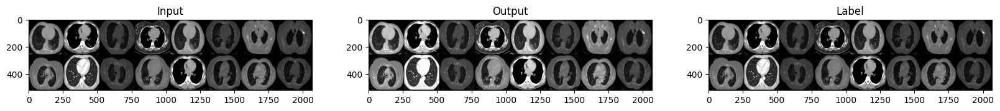


  4%|▎         | 1/27 [00:06<02:59,  6.89s/it]

Train Epoch: 11 [0/418 (0%)]	Loss: 0.719256


 41%|████      | 11/27 [00:20<00:22,  1.43s/it]

Train Epoch: 11 [20/418 (37%)]	Loss: 0.320120


 78%|███████▊  | 21/27 [00:34<00:08,  1.39s/it]

Train Epoch: 11 [40/418 (74%)]	Loss: 0.311485


100%|██████████| 27/27 [00:42<00:00,  1.58s/it]


Mean loss on trainset: 12.217033684253693



  0%|          | 0/195 [00:00<?, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


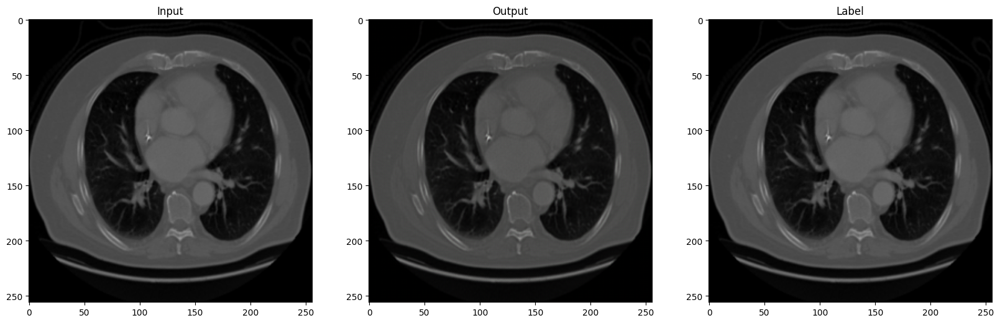


  1%|          | 1/195 [00:01<03:25,  1.06s/it]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Test Epoch: 11 [0/195 (0%)]	Loss: 0.296703


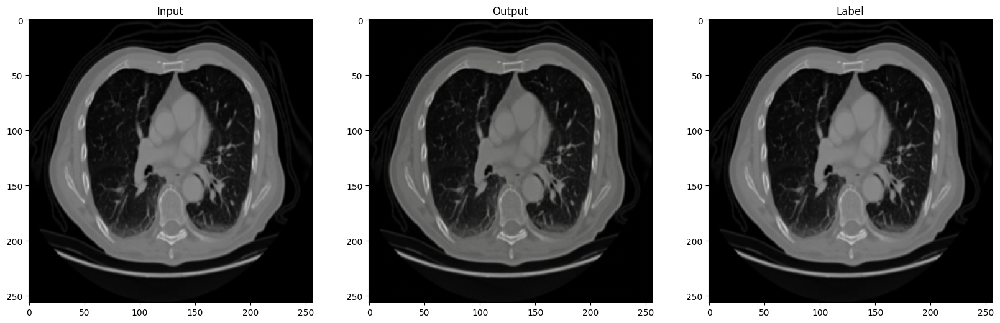


  1%|          | 2/195 [00:02<03:31,  1.10s/it]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


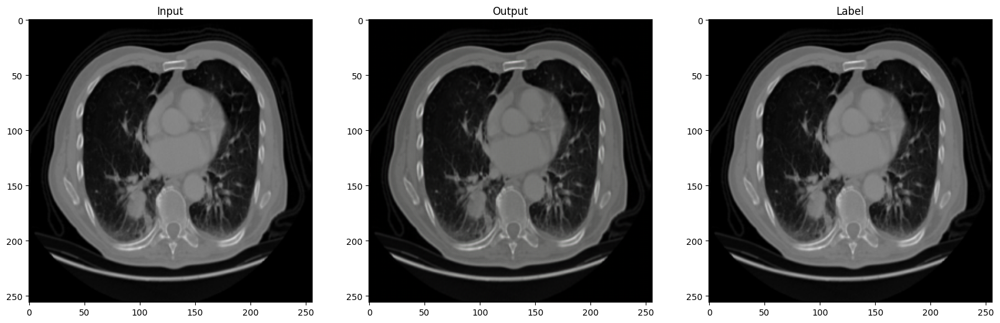

  7%|▋         | 14/195 [00:03<00:21,  8.31it/s]

Test Epoch: 11 [20/195 (5%)]	Loss: 0.191534


 13%|█▎        | 26/195 [00:04<00:09, 18.03it/s]

Test Epoch: 11 [40/195 (10%)]	Loss: 0.233257


 18%|█▊        | 35/195 [00:04<00:07, 21.87it/s]

Test Epoch: 11 [60/195 (15%)]	Loss: 0.140319


 23%|██▎       | 44/195 [00:05<00:06, 23.69it/s]

Test Epoch: 11 [80/195 (21%)]	Loss: 0.200520


 29%|██▊       | 56/195 [00:05<00:05, 24.43it/s]

Test Epoch: 11 [100/195 (26%)]	Loss: 0.215587


 33%|███▎      | 65/195 [00:05<00:05, 24.47it/s]

Test Epoch: 11 [120/195 (31%)]	Loss: 0.243794


 38%|███▊      | 74/195 [00:06<00:04, 24.76it/s]

Test Epoch: 11 [140/195 (36%)]	Loss: 0.230686


 44%|████▍     | 86/195 [00:06<00:04, 24.48it/s]

Test Epoch: 11 [160/195 (41%)]	Loss: 0.203401


 49%|████▊     | 95/195 [00:07<00:04, 24.61it/s]

Test Epoch: 11 [180/195 (46%)]	Loss: 0.184006


 53%|█████▎    | 104/195 [00:07<00:03, 24.76it/s]

Test Epoch: 11 [200/195 (51%)]	Loss: 0.166711


 59%|█████▉    | 116/195 [00:08<00:03, 24.47it/s]

Test Epoch: 11 [220/195 (56%)]	Loss: 0.234308


 64%|██████▍   | 125/195 [00:08<00:02, 24.60it/s]

Test Epoch: 11 [240/195 (62%)]	Loss: 0.195172


 69%|██████▊   | 134/195 [00:08<00:02, 24.79it/s]

Test Epoch: 11 [260/195 (67%)]	Loss: 0.181125


 73%|███████▎  | 143/195 [00:09<00:02, 23.80it/s]

Test Epoch: 11 [280/195 (72%)]	Loss: 0.217770


 79%|███████▉  | 155/195 [00:09<00:01, 23.25it/s]

Test Epoch: 11 [300/195 (77%)]	Loss: 0.441129


 84%|████████▍ | 164/195 [00:10<00:01, 23.41it/s]

Test Epoch: 11 [320/195 (82%)]	Loss: 0.428787


 90%|█████████ | 176/195 [00:10<00:00, 23.79it/s]

Test Epoch: 11 [340/195 (87%)]	Loss: 0.252522


 95%|█████████▍| 185/195 [00:10<00:00, 23.01it/s]

Test Epoch: 11 [360/195 (92%)]	Loss: 0.161015


100%|██████████| 195/195 [00:11<00:00, 17.13it/s]

Test Epoch: 11 [380/195 (97%)]	Loss: 0.427097
Test loss: 47.05830383300781
Saving best model at /content/drive/MyDrive/Super_Resolution_DL2020/Python/checkpoints/checkpoints_22112023_191747_best.pth


Saving current model at /content/drive/MyDrive/Super_Resolution_DL2020/Python/checkpoints/checkpoints_22112023_191747_current.pth
Learning rate : 0.001



  0%|          | 0/27 [00:00<?, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


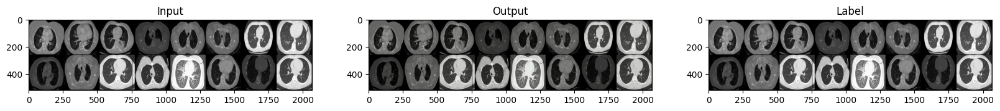


  4%|▎         | 1/27 [00:08<03:46,  8.72s/it]

Train Epoch: 12 [0/418 (0%)]	Loss: 0.292976


 41%|████      | 11/27 [00:22<00:22,  1.44s/it]

Train Epoch: 12 [20/418 (37%)]	Loss: 0.329773


 78%|███████▊  | 21/27 [00:36<00:08,  1.40s/it]

Train Epoch: 12 [40/418 (74%)]	Loss: 0.331790


100%|██████████| 27/27 [00:44<00:00,  1.64s/it]


Mean loss on trainset: 7.043322816491127



  0%|          | 0/195 [00:00<?, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


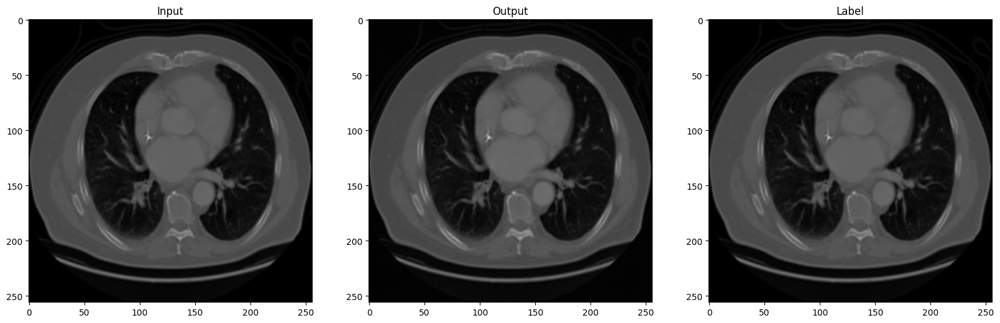


  1%|          | 1/195 [00:01<03:32,  1.09s/it]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Test Epoch: 12 [0/195 (0%)]	Loss: 0.140750


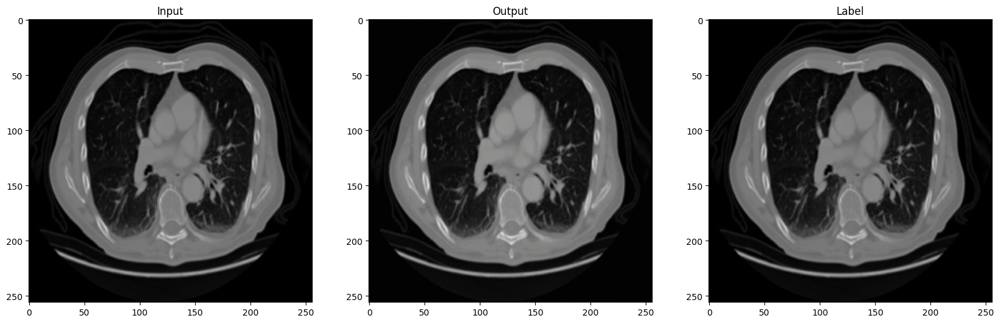


  1%|          | 2/195 [00:02<03:30,  1.09s/it]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


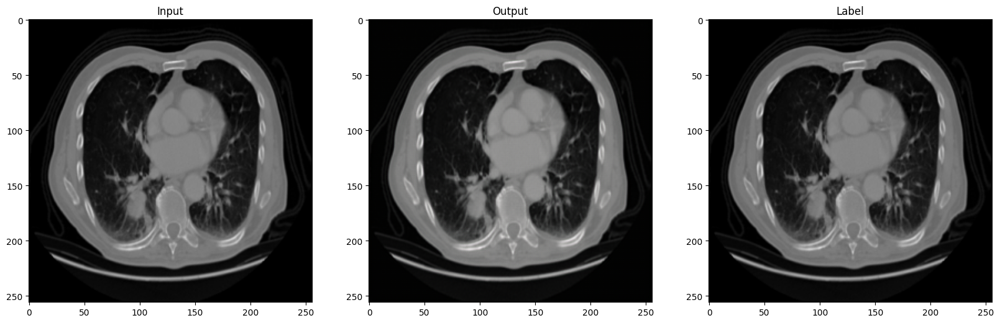

  7%|▋         | 14/195 [00:03<00:21,  8.45it/s]

Test Epoch: 12 [20/195 (5%)]	Loss: 0.152672


 13%|█▎        | 26/195 [00:04<00:09, 17.96it/s]

Test Epoch: 12 [40/195 (10%)]	Loss: 0.216808


 18%|█▊        | 35/195 [00:04<00:07, 21.45it/s]

Test Epoch: 12 [60/195 (15%)]	Loss: 0.097519


 23%|██▎       | 44/195 [00:05<00:06, 22.97it/s]

Test Epoch: 12 [80/195 (21%)]	Loss: 0.154053


 29%|██▊       | 56/195 [00:05<00:05, 24.12it/s]

Test Epoch: 12 [100/195 (26%)]	Loss: 0.206917


 33%|███▎      | 65/195 [00:05<00:05, 24.27it/s]

Test Epoch: 12 [120/195 (31%)]	Loss: 0.165526


 38%|███▊      | 74/195 [00:06<00:05, 24.19it/s]

Test Epoch: 12 [140/195 (36%)]	Loss: 0.148667


 44%|████▍     | 86/195 [00:06<00:04, 24.23it/s]

Test Epoch: 12 [160/195 (41%)]	Loss: 0.144177


 49%|████▊     | 95/195 [00:07<00:04, 24.39it/s]

Test Epoch: 12 [180/195 (46%)]	Loss: 0.187342


 53%|█████▎    | 104/195 [00:07<00:03, 24.66it/s]

Test Epoch: 12 [200/195 (51%)]	Loss: 0.180377


 59%|█████▉    | 116/195 [00:08<00:03, 24.13it/s]

Test Epoch: 12 [220/195 (56%)]	Loss: 0.172418


 64%|██████▍   | 125/195 [00:08<00:02, 23.88it/s]

Test Epoch: 12 [240/195 (62%)]	Loss: 0.162636


 69%|██████▊   | 134/195 [00:08<00:02, 24.41it/s]

Test Epoch: 12 [260/195 (67%)]	Loss: 0.156337


 73%|███████▎  | 143/195 [00:09<00:02, 23.83it/s]

Test Epoch: 12 [280/195 (72%)]	Loss: 0.186765


 79%|███████▉  | 155/195 [00:09<00:01, 22.86it/s]

Test Epoch: 12 [300/195 (77%)]	Loss: 1.137414


 84%|████████▍ | 164/195 [00:10<00:01, 23.00it/s]

Test Epoch: 12 [320/195 (82%)]	Loss: 1.034721


 90%|█████████ | 176/195 [00:10<00:00, 23.41it/s]

Test Epoch: 12 [340/195 (87%)]	Loss: 0.988387


 95%|█████████▍| 185/195 [00:11<00:00, 22.60it/s]

Test Epoch: 12 [360/195 (92%)]	Loss: 0.404921


100%|██████████| 195/195 [00:11<00:00, 17.01it/s]

Test Epoch: 12 [380/195 (97%)]	Loss: 1.556037


Test loss: 68.72782897949219
Saving current model at /content/drive/MyDrive/Super_Resolution_DL2020/Python/checkpoints/checkpoints_22112023_191747_current.pth
Learning rate : 0.001



  0%|          | 0/27 [00:00<?, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


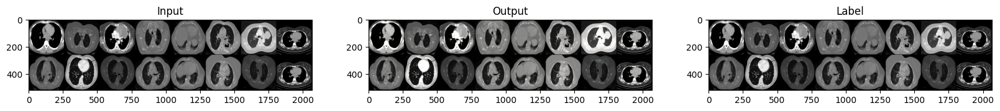


  4%|▎         | 1/27 [00:07<03:08,  7.25s/it]

Train Epoch: 13 [0/418 (0%)]	Loss: 0.531278


 41%|████      | 11/27 [00:20<00:22,  1.42s/it]

Train Epoch: 13 [20/418 (37%)]	Loss: 0.831280


 78%|███████▊  | 21/27 [00:34<00:08,  1.39s/it]

Train Epoch: 13 [40/418 (74%)]	Loss: 0.253573


100%|██████████| 27/27 [00:43<00:00,  1.60s/it]


Mean loss on trainset: 12.684010356664658



  0%|          | 0/195 [00:00<?, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


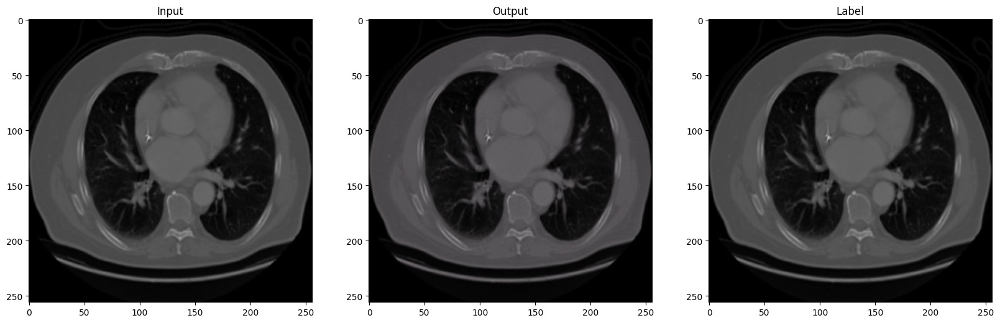


  1%|          | 1/195 [00:01<04:09,  1.29s/it]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Test Epoch: 13 [0/195 (0%)]	Loss: 0.212834


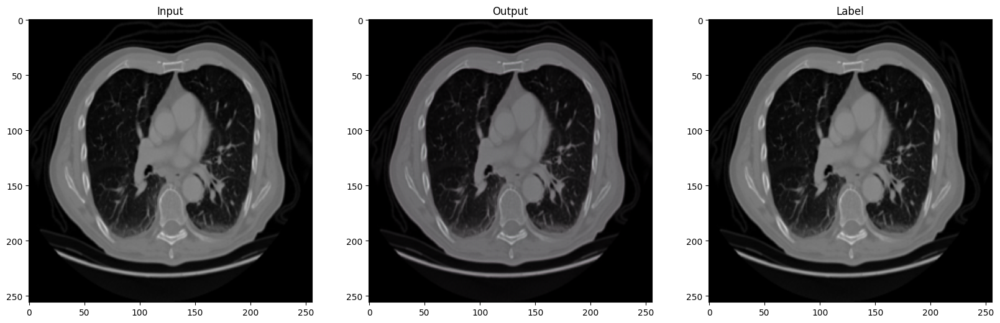


  1%|          | 2/195 [00:02<03:50,  1.19s/it]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


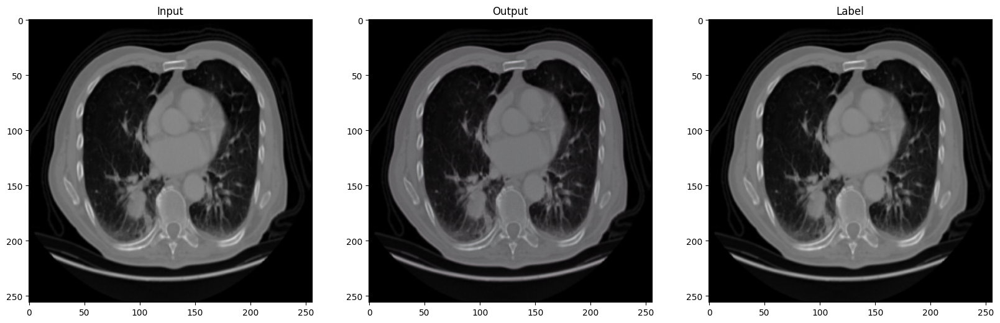

  7%|▋         | 14/195 [00:04<00:22,  8.06it/s]

Test Epoch: 13 [20/195 (5%)]	Loss: 0.235702


 13%|█▎        | 26/195 [00:04<00:09, 17.33it/s]

Test Epoch: 13 [40/195 (10%)]	Loss: 0.296159


 18%|█▊        | 35/195 [00:05<00:07, 21.55it/s]

Test Epoch: 13 [60/195 (15%)]	Loss: 0.173371


 23%|██▎       | 44/195 [00:05<00:06, 23.32it/s]

Test Epoch: 13 [80/195 (21%)]	Loss: 0.229549


 29%|██▊       | 56/195 [00:05<00:05, 23.98it/s]

Test Epoch: 13 [100/195 (26%)]	Loss: 0.246172


 33%|███▎      | 65/195 [00:06<00:05, 24.48it/s]

Test Epoch: 13 [120/195 (31%)]	Loss: 0.220712


 38%|███▊      | 74/195 [00:06<00:04, 24.48it/s]

Test Epoch: 13 [140/195 (36%)]	Loss: 0.252479


 44%|████▍     | 86/195 [00:07<00:04, 24.54it/s]

Test Epoch: 13 [160/195 (41%)]	Loss: 0.241642


 49%|████▊     | 95/195 [00:07<00:04, 24.55it/s]

Test Epoch: 13 [180/195 (46%)]	Loss: 0.255194


 53%|█████▎    | 104/195 [00:07<00:03, 24.25it/s]

Test Epoch: 13 [200/195 (51%)]	Loss: 0.220446


 59%|█████▉    | 116/195 [00:08<00:03, 24.44it/s]

Test Epoch: 13 [220/195 (56%)]	Loss: 0.231901


 64%|██████▍   | 125/195 [00:08<00:02, 24.51it/s]

Test Epoch: 13 [240/195 (62%)]	Loss: 0.224783


 69%|██████▉   | 135/195 [00:09<00:02, 24.91it/s]

Test Epoch: 13 [260/195 (67%)]	Loss: 0.242083


 74%|███████▍  | 144/195 [00:09<00:02, 23.74it/s]

Test Epoch: 13 [280/195 (72%)]	Loss: 0.242745


 80%|████████  | 156/195 [00:10<00:01, 23.97it/s]

Test Epoch: 13 [300/195 (77%)]	Loss: 1.614628


 85%|████████▍ | 165/195 [00:10<00:01, 23.90it/s]

Test Epoch: 13 [320/195 (82%)]	Loss: 1.567510


 89%|████████▉ | 174/195 [00:10<00:00, 23.94it/s]

Test Epoch: 13 [340/195 (87%)]	Loss: 1.309808


 95%|█████████▌| 186/195 [00:11<00:00, 23.41it/s]

Test Epoch: 13 [360/195 (92%)]	Loss: 0.785761


100%|██████████| 195/195 [00:11<00:00, 16.70it/s]

Test Epoch: 13 [380/195 (97%)]	Loss: 2.550583
Test loss: 102.85733032226562
Saving current model at /content/drive/MyDrive/Super_Resolution_DL2020/Python/checkpoints/checkpoints_22112023_191747_current.pth


Learning rate : 0.001



  0%|          | 0/27 [00:00<?, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


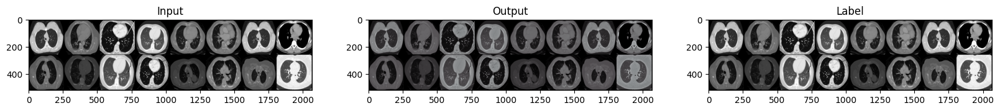


  4%|▎         | 1/27 [00:07<03:15,  7.53s/it]

Train Epoch: 14 [0/418 (0%)]	Loss: 0.916344


 41%|████      | 11/27 [00:21<00:22,  1.43s/it]

Train Epoch: 14 [20/418 (37%)]	Loss: 0.320782


 78%|███████▊  | 21/27 [00:35<00:08,  1.39s/it]

Train Epoch: 14 [40/418 (74%)]	Loss: 0.429867


100%|██████████| 27/27 [00:43<00:00,  1.61s/it]


Mean loss on trainset: 12.903004586696625



  0%|          | 0/195 [00:00<?, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


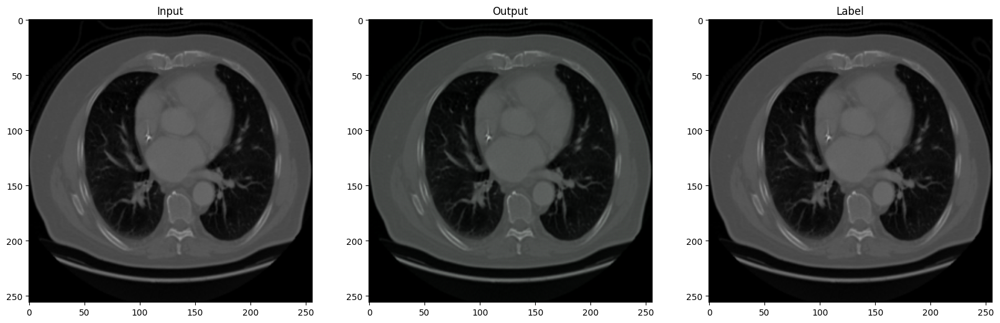


  1%|          | 1/195 [00:01<03:36,  1.12s/it]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Test Epoch: 14 [0/195 (0%)]	Loss: 0.140211


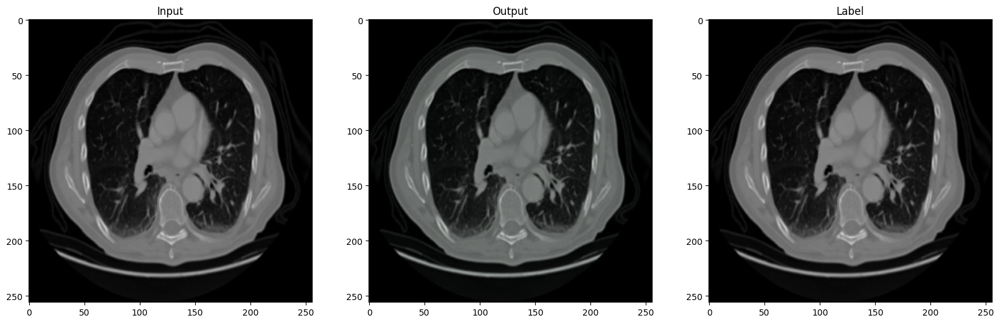


  1%|          | 2/195 [00:02<04:08,  1.29s/it]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


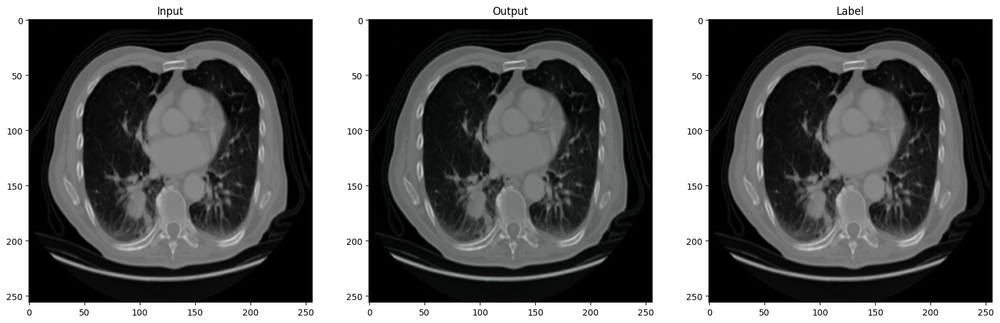

  7%|▋         | 14/195 [00:04<00:22,  8.14it/s]

Test Epoch: 14 [20/195 (5%)]	Loss: 0.123284


 13%|█▎        | 26/195 [00:04<00:09, 17.78it/s]

Test Epoch: 14 [40/195 (10%)]	Loss: 0.167882


 18%|█▊        | 35/195 [00:04<00:07, 21.64it/s]

Test Epoch: 14 [60/195 (15%)]	Loss: 0.097761


 23%|██▎       | 44/195 [00:05<00:06, 23.51it/s]

Test Epoch: 14 [80/195 (21%)]	Loss: 0.128818


 29%|██▊       | 56/195 [00:05<00:05, 24.30it/s]

Test Epoch: 14 [100/195 (26%)]	Loss: 0.166686


 33%|███▎      | 65/195 [00:06<00:05, 24.38it/s]

Test Epoch: 14 [120/195 (31%)]	Loss: 0.129272


 38%|███▊      | 74/195 [00:06<00:04, 24.46it/s]

Test Epoch: 14 [140/195 (36%)]	Loss: 0.130170


 44%|████▍     | 86/195 [00:07<00:04, 24.16it/s]

Test Epoch: 14 [160/195 (41%)]	Loss: 0.126428


 49%|████▊     | 95/195 [00:07<00:04, 24.63it/s]

Test Epoch: 14 [180/195 (46%)]	Loss: 0.152936


 53%|█████▎    | 104/195 [00:07<00:03, 24.97it/s]

Test Epoch: 14 [200/195 (51%)]	Loss: 0.132542


 59%|█████▉    | 116/195 [00:08<00:03, 24.68it/s]

Test Epoch: 14 [220/195 (56%)]	Loss: 0.138667


 64%|██████▍   | 125/195 [00:08<00:02, 24.73it/s]

Test Epoch: 14 [240/195 (62%)]	Loss: 0.129276


 69%|██████▊   | 134/195 [00:08<00:02, 24.42it/s]

Test Epoch: 14 [260/195 (67%)]	Loss: 0.126945


 73%|███████▎  | 143/195 [00:09<00:02, 23.62it/s]

Test Epoch: 14 [280/195 (72%)]	Loss: 0.161640


 79%|███████▉  | 155/195 [00:09<00:01, 23.45it/s]

Test Epoch: 14 [300/195 (77%)]	Loss: 0.576337


 84%|████████▍ | 164/195 [00:10<00:01, 23.56it/s]

Test Epoch: 14 [320/195 (82%)]	Loss: 0.588151


 90%|█████████ | 176/195 [00:10<00:00, 23.45it/s]

Test Epoch: 14 [340/195 (87%)]	Loss: 0.427354


 95%|█████████▍| 185/195 [00:11<00:00, 23.00it/s]

Test Epoch: 14 [360/195 (92%)]	Loss: 0.245681


100%|██████████| 195/195 [00:11<00:00, 16.79it/s]

Test Epoch: 14 [380/195 (97%)]	Loss: 0.684053
Test loss: 44.27912139892578
Saving best model at /content/drive/MyDrive/Super_Resolution_DL2020/Python/checkpoints/checkpoints_22112023_191747_best.pth


Saving current model at /content/drive/MyDrive/Super_Resolution_DL2020/Python/checkpoints/checkpoints_22112023_191747_current.pth
Learning rate : 0.001



  0%|          | 0/27 [00:00<?, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


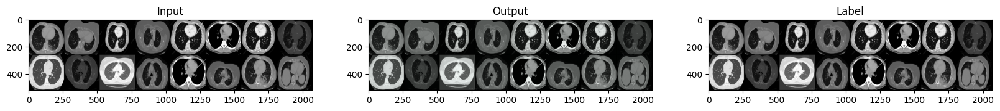


  4%|▎         | 1/27 [00:07<03:16,  7.55s/it]

Train Epoch: 15 [0/418 (0%)]	Loss: 0.269661


 41%|████      | 11/27 [00:21<00:22,  1.43s/it]

Train Epoch: 15 [20/418 (37%)]	Loss: 0.155258


 78%|███████▊  | 21/27 [00:35<00:08,  1.40s/it]

Train Epoch: 15 [40/418 (74%)]	Loss: 0.483954


100%|██████████| 27/27 [00:43<00:00,  1.60s/it]


Mean loss on trainset: 9.810592263936996



  0%|          | 0/195 [00:00<?, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


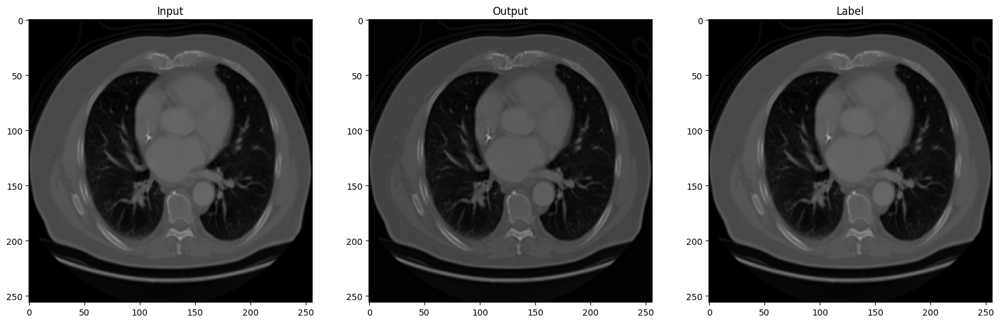


  1%|          | 1/195 [00:01<03:22,  1.04s/it]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Test Epoch: 15 [0/195 (0%)]	Loss: 0.168907


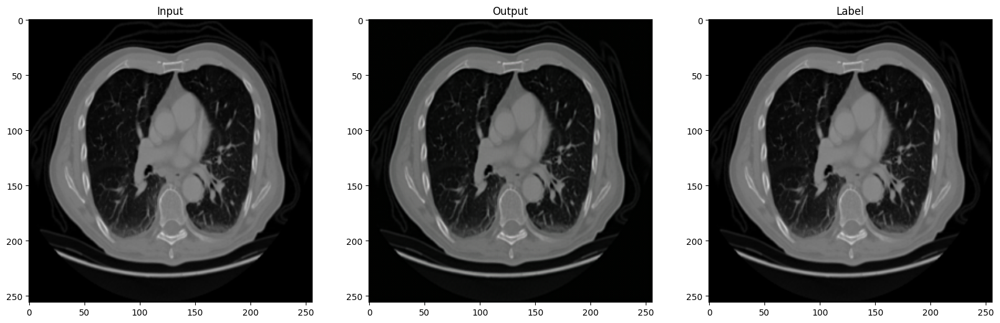


  1%|          | 2/195 [00:02<03:21,  1.04s/it]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


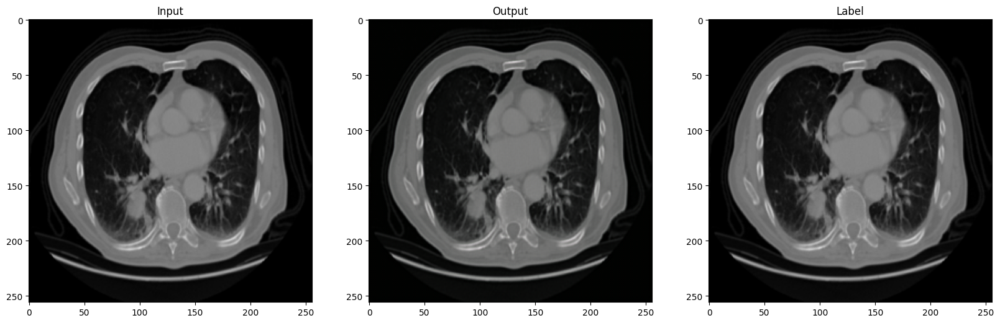

  8%|▊         | 15/195 [00:03<00:18,  9.60it/s]

Test Epoch: 15 [20/195 (5%)]	Loss: 0.155164


 12%|█▏        | 24/195 [00:04<00:10, 16.58it/s]

Test Epoch: 15 [40/195 (10%)]	Loss: 0.176382


 18%|█▊        | 36/195 [00:04<00:07, 21.96it/s]

Test Epoch: 15 [60/195 (15%)]	Loss: 0.164514


 23%|██▎       | 45/195 [00:04<00:06, 23.61it/s]

Test Epoch: 15 [80/195 (21%)]	Loss: 0.166962


 28%|██▊       | 54/195 [00:05<00:06, 23.46it/s]

Test Epoch: 15 [100/195 (26%)]	Loss: 0.168034


 34%|███▍      | 66/195 [00:05<00:05, 23.64it/s]

Test Epoch: 15 [120/195 (31%)]	Loss: 0.152403


 38%|███▊      | 75/195 [00:06<00:05, 23.73it/s]

Test Epoch: 15 [140/195 (36%)]	Loss: 0.148209


 43%|████▎     | 84/195 [00:06<00:04, 24.34it/s]

Test Epoch: 15 [160/195 (41%)]	Loss: 0.147710


 49%|████▉     | 96/195 [00:07<00:04, 24.18it/s]

Test Epoch: 15 [180/195 (46%)]	Loss: 0.169059


 54%|█████▍    | 105/195 [00:07<00:03, 23.99it/s]

Test Epoch: 15 [200/195 (51%)]	Loss: 0.145850


 58%|█████▊    | 114/195 [00:07<00:03, 24.38it/s]

Test Epoch: 15 [220/195 (56%)]	Loss: 0.161830


 65%|██████▍   | 126/195 [00:08<00:02, 24.03it/s]

Test Epoch: 15 [240/195 (62%)]	Loss: 0.155810


 69%|██████▉   | 135/195 [00:08<00:02, 23.84it/s]

Test Epoch: 15 [260/195 (67%)]	Loss: 0.134056


 74%|███████▍  | 144/195 [00:09<00:02, 22.86it/s]

Test Epoch: 15 [280/195 (72%)]	Loss: 0.170231


 80%|████████  | 156/195 [00:09<00:01, 23.24it/s]

Test Epoch: 15 [300/195 (77%)]	Loss: 0.371251


 85%|████████▍ | 165/195 [00:09<00:01, 23.55it/s]

Test Epoch: 15 [320/195 (82%)]	Loss: 0.363951


 89%|████████▉ | 174/195 [00:10<00:00, 23.58it/s]

Test Epoch: 15 [340/195 (87%)]	Loss: 0.301657


 94%|█████████▍| 183/195 [00:10<00:00, 22.30it/s]

Test Epoch: 15 [360/195 (92%)]	Loss: 0.198118


100%|██████████| 195/195 [00:11<00:00, 17.26it/s]

Test Epoch: 15 [380/195 (97%)]	Loss: 0.378921
Test loss: 40.281639099121094
Saving best model at /content/drive/MyDrive/Super_Resolution_DL2020/Python/checkpoints/checkpoints_22112023_191747_best.pth


Saving current model at /content/drive/MyDrive/Super_Resolution_DL2020/Python/checkpoints/checkpoints_22112023_191747_current.pth
Learning rate : 0.001



  0%|          | 0/27 [00:00<?, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


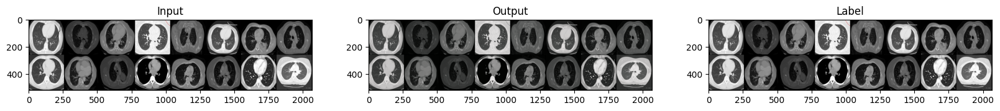


  4%|▎         | 1/27 [00:07<03:11,  7.37s/it]

Train Epoch: 16 [0/418 (0%)]	Loss: 0.375643


 41%|████      | 11/27 [00:21<00:22,  1.43s/it]

Train Epoch: 16 [20/418 (37%)]	Loss: 0.555173


 78%|███████▊  | 21/27 [00:34<00:08,  1.39s/it]

Train Epoch: 16 [40/418 (74%)]	Loss: 0.150221


100%|██████████| 27/27 [00:43<00:00,  1.60s/it]


Mean loss on trainset: 10.242117136716843



  0%|          | 0/195 [00:00<?, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


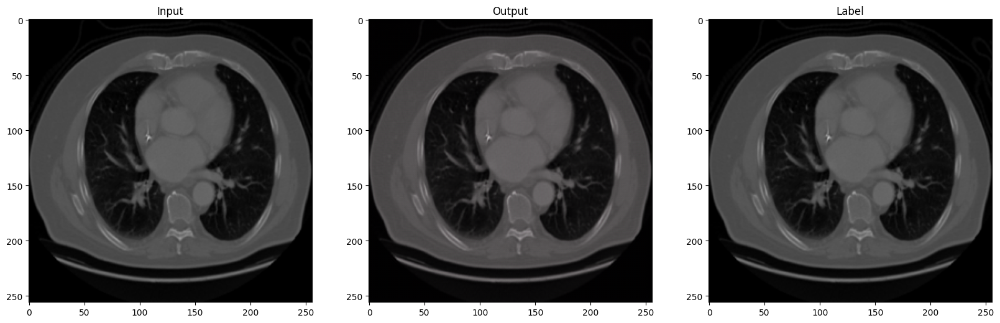


  1%|          | 1/195 [00:01<03:48,  1.18s/it]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Test Epoch: 16 [0/195 (0%)]	Loss: 0.112907


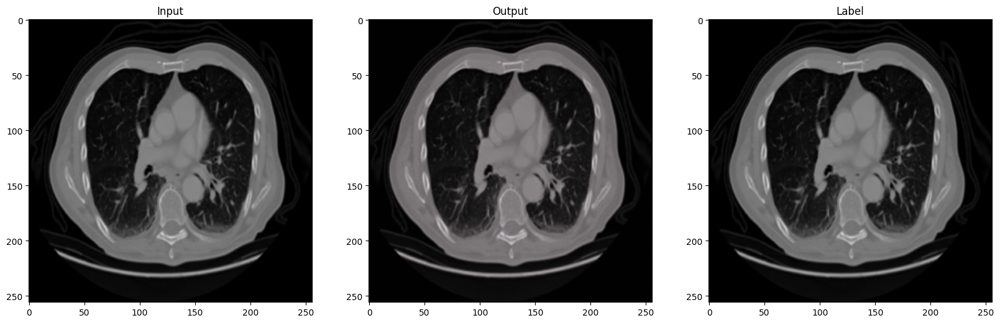


  1%|          | 2/195 [00:02<03:41,  1.15s/it]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


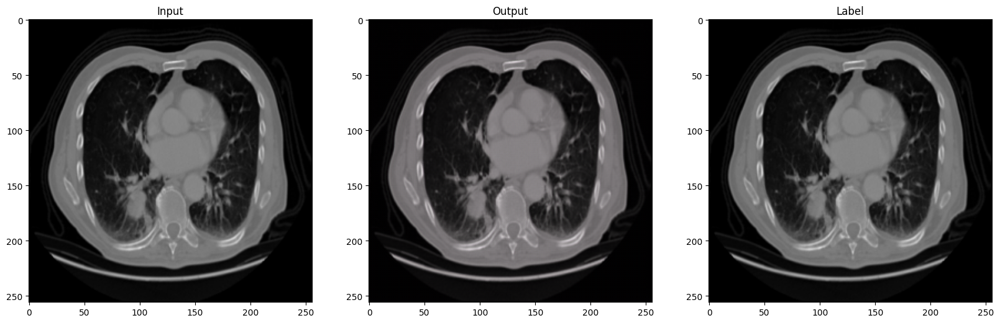

  8%|▊         | 15/195 [00:04<00:20,  9.00it/s]

Test Epoch: 16 [20/195 (5%)]	Loss: 0.096667


 13%|█▎        | 25/195 [00:04<00:10, 16.76it/s]

Test Epoch: 16 [40/195 (10%)]	Loss: 0.117011


 17%|█▋        | 34/195 [00:04<00:07, 21.04it/s]

Test Epoch: 16 [60/195 (15%)]	Loss: 0.095142


 24%|██▎       | 46/195 [00:05<00:06, 23.64it/s]

Test Epoch: 16 [80/195 (21%)]	Loss: 0.100230


 28%|██▊       | 55/195 [00:05<00:05, 24.28it/s]

Test Epoch: 16 [100/195 (26%)]	Loss: 0.111273


 33%|███▎      | 64/195 [00:06<00:05, 24.33it/s]

Test Epoch: 16 [120/195 (31%)]	Loss: 0.100943


 39%|███▉      | 76/195 [00:06<00:04, 24.45it/s]

Test Epoch: 16 [140/195 (36%)]	Loss: 0.100193


 44%|████▎     | 85/195 [00:06<00:04, 24.29it/s]

Test Epoch: 16 [160/195 (41%)]	Loss: 0.102739


 49%|████▊     | 95/195 [00:07<00:04, 24.85it/s]

Test Epoch: 16 [180/195 (46%)]	Loss: 0.106117


 53%|█████▎    | 104/195 [00:07<00:03, 24.69it/s]

Test Epoch: 16 [200/195 (51%)]	Loss: 0.099880


 59%|█████▉    | 116/195 [00:08<00:03, 24.47it/s]

Test Epoch: 16 [220/195 (56%)]	Loss: 0.103264


 64%|██████▍   | 125/195 [00:08<00:02, 24.50it/s]

Test Epoch: 16 [240/195 (62%)]	Loss: 0.100470


 69%|██████▊   | 134/195 [00:08<00:02, 24.51it/s]

Test Epoch: 16 [260/195 (67%)]	Loss: 0.100809


 73%|███████▎  | 143/195 [00:09<00:02, 23.42it/s]

Test Epoch: 16 [280/195 (72%)]	Loss: 0.113313


 79%|███████▉  | 155/195 [00:09<00:01, 23.21it/s]

Test Epoch: 16 [300/195 (77%)]	Loss: 0.372382


 84%|████████▍ | 164/195 [00:10<00:01, 23.39it/s]

Test Epoch: 16 [320/195 (82%)]	Loss: 0.371154


 90%|█████████ | 176/195 [00:10<00:00, 23.76it/s]

Test Epoch: 16 [340/195 (87%)]	Loss: 0.296147


 95%|█████████▍| 185/195 [00:11<00:00, 22.65it/s]

Test Epoch: 16 [360/195 (92%)]	Loss: 0.172381


100%|██████████| 195/195 [00:11<00:00, 16.91it/s]

Test Epoch: 16 [380/195 (97%)]	Loss: 0.408489
Test loss: 30.450469970703125
Saving best model at /content/drive/MyDrive/Super_Resolution_DL2020/Python/checkpoints/checkpoints_22112023_191747_best.pth


Saving current model at /content/drive/MyDrive/Super_Resolution_DL2020/Python/checkpoints/checkpoints_22112023_191747_current.pth
Learning rate : 0.001



  0%|          | 0/27 [00:00<?, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


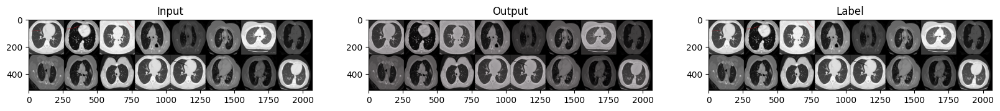


  4%|▎         | 1/27 [00:07<03:27,  7.99s/it]

Train Epoch: 17 [0/418 (0%)]	Loss: 0.730062


 41%|████      | 11/27 [00:21<00:22,  1.43s/it]

Train Epoch: 17 [20/418 (37%)]	Loss: 0.256365


 78%|███████▊  | 21/27 [00:35<00:08,  1.40s/it]

Train Epoch: 17 [40/418 (74%)]	Loss: 0.179421


100%|██████████| 27/27 [00:43<00:00,  1.62s/it]


Mean loss on trainset: 8.066178135573864



  0%|          | 0/195 [00:00<?, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


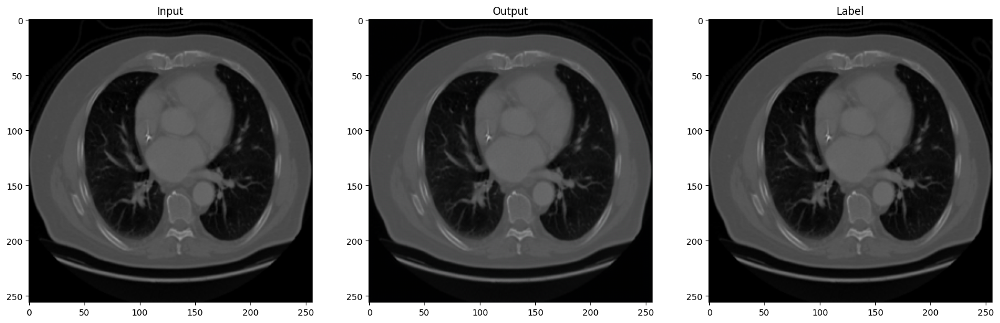


  1%|          | 1/195 [00:01<03:19,  1.03s/it]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Test Epoch: 17 [0/195 (0%)]	Loss: 0.156017


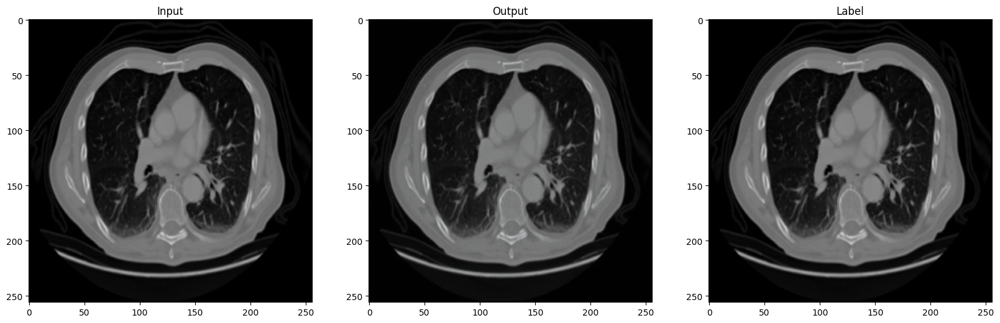


  1%|          | 2/195 [00:02<03:15,  1.01s/it]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


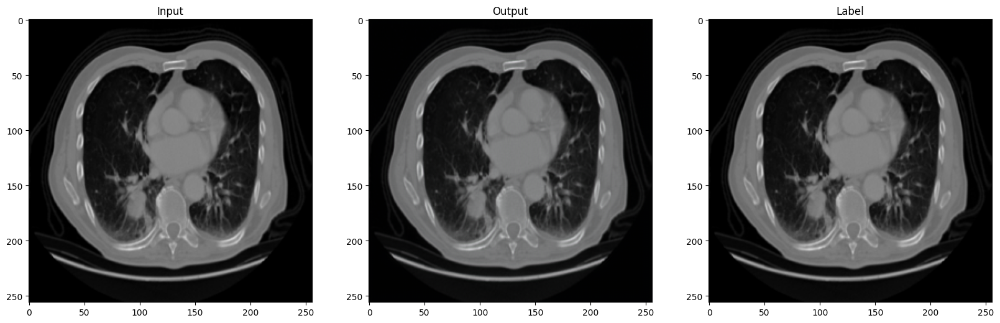

  7%|▋         | 14/195 [00:03<00:19,  9.09it/s]

Test Epoch: 17 [20/195 (5%)]	Loss: 0.099699


 13%|█▎        | 26/195 [00:04<00:09, 18.52it/s]

Test Epoch: 17 [40/195 (10%)]	Loss: 0.132740


 18%|█▊        | 35/195 [00:04<00:07, 22.01it/s]

Test Epoch: 17 [60/195 (15%)]	Loss: 0.133756


 23%|██▎       | 44/195 [00:04<00:06, 23.70it/s]

Test Epoch: 17 [80/195 (21%)]	Loss: 0.105102


 29%|██▊       | 56/195 [00:05<00:05, 24.36it/s]

Test Epoch: 17 [100/195 (26%)]	Loss: 0.125861


 33%|███▎      | 65/195 [00:05<00:05, 23.99it/s]

Test Epoch: 17 [120/195 (31%)]	Loss: 0.101157


 38%|███▊      | 74/195 [00:06<00:05, 23.95it/s]

Test Epoch: 17 [140/195 (36%)]	Loss: 0.104325


 44%|████▍     | 86/195 [00:06<00:04, 23.53it/s]

Test Epoch: 17 [160/195 (41%)]	Loss: 0.105294


 49%|████▊     | 95/195 [00:06<00:04, 24.28it/s]

Test Epoch: 17 [180/195 (46%)]	Loss: 0.117075


 53%|█████▎    | 104/195 [00:07<00:03, 24.61it/s]

Test Epoch: 17 [200/195 (51%)]	Loss: 0.108352


 59%|█████▉    | 116/195 [00:07<00:03, 24.31it/s]

Test Epoch: 17 [220/195 (56%)]	Loss: 0.106137


 64%|██████▍   | 125/195 [00:08<00:02, 24.39it/s]

Test Epoch: 17 [240/195 (62%)]	Loss: 0.106847


 69%|██████▊   | 134/195 [00:08<00:02, 24.61it/s]

Test Epoch: 17 [260/195 (67%)]	Loss: 0.096441


 73%|███████▎  | 143/195 [00:08<00:02, 23.60it/s]

Test Epoch: 17 [280/195 (72%)]	Loss: 0.132521


 79%|███████▉  | 155/195 [00:09<00:01, 23.27it/s]

Test Epoch: 17 [300/195 (77%)]	Loss: 0.407404


 84%|████████▍ | 164/195 [00:09<00:01, 22.54it/s]

Test Epoch: 17 [320/195 (82%)]	Loss: 0.416339


 90%|█████████ | 176/195 [00:10<00:00, 23.42it/s]

Test Epoch: 17 [340/195 (87%)]	Loss: 0.283195


 95%|█████████▍| 185/195 [00:10<00:00, 21.41it/s]

Test Epoch: 17 [360/195 (92%)]	Loss: 0.174816


100%|██████████| 195/195 [00:11<00:00, 17.31it/s]

Test Epoch: 17 [380/195 (97%)]	Loss: 0.509780
Test loss: 34.01070785522461
Saving current model at /content/drive/MyDrive/Super_Resolution_DL2020/Python/checkpoints/checkpoints_22112023_191747_current.pth


Learning rate : 0.001



  0%|          | 0/27 [00:00<?, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


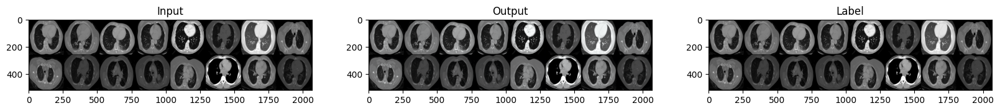


  4%|▎         | 1/27 [00:07<03:14,  7.47s/it]

Train Epoch: 18 [0/418 (0%)]	Loss: 0.153330


 41%|████      | 11/27 [00:21<00:22,  1.43s/it]

Train Epoch: 18 [20/418 (37%)]	Loss: 0.267816


 78%|███████▊  | 21/27 [00:35<00:08,  1.39s/it]

Train Epoch: 18 [40/418 (74%)]	Loss: 0.178000


100%|██████████| 27/27 [00:43<00:00,  1.61s/it]


Mean loss on trainset: 11.592534556984901



  0%|          | 0/195 [00:00<?, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


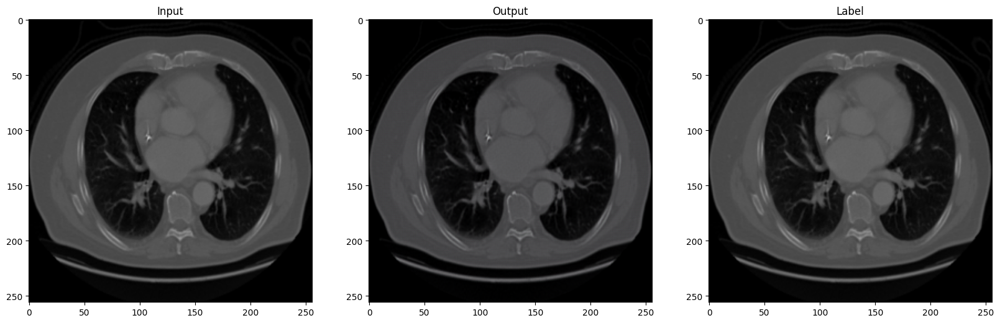


  1%|          | 1/195 [00:01<03:48,  1.18s/it]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Test Epoch: 18 [0/195 (0%)]	Loss: 0.234524


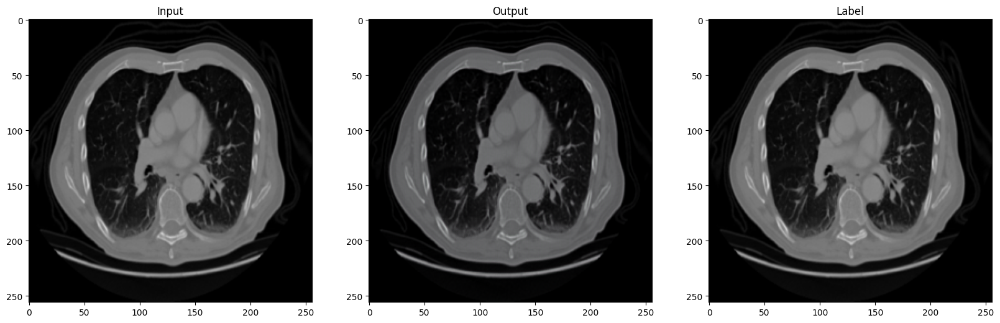


  1%|          | 2/195 [00:02<03:54,  1.21s/it]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


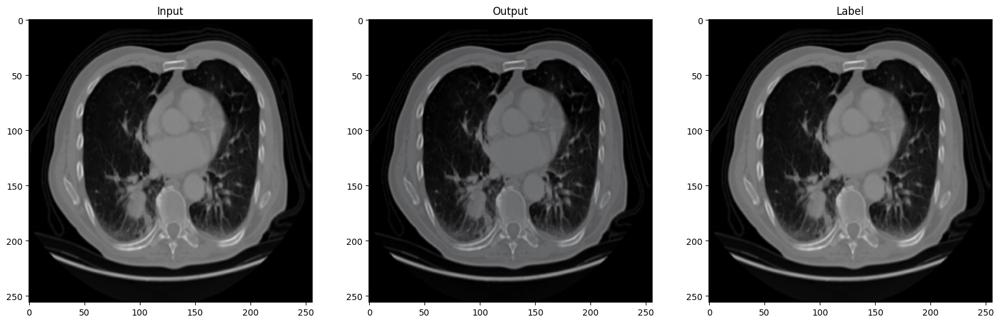

  7%|▋         | 14/195 [00:04<00:22,  7.93it/s]

Test Epoch: 18 [20/195 (5%)]	Loss: 0.246078


 13%|█▎        | 26/195 [00:04<00:09, 17.14it/s]

Test Epoch: 18 [40/195 (10%)]	Loss: 0.315362


 18%|█▊        | 35/195 [00:05<00:07, 21.23it/s]

Test Epoch: 18 [60/195 (15%)]	Loss: 0.175643


 23%|██▎       | 44/195 [00:05<00:06, 23.15it/s]

Test Epoch: 18 [80/195 (21%)]	Loss: 0.252018


 29%|██▊       | 56/195 [00:05<00:05, 23.63it/s]

Test Epoch: 18 [100/195 (26%)]	Loss: 0.307709


 33%|███▎      | 65/195 [00:06<00:05, 24.16it/s]

Test Epoch: 18 [120/195 (31%)]	Loss: 0.242460


 38%|███▊      | 74/195 [00:06<00:05, 21.32it/s]

Test Epoch: 18 [140/195 (36%)]	Loss: 0.248605


 43%|████▎     | 83/195 [00:07<00:04, 22.47it/s]

Test Epoch: 18 [160/195 (41%)]	Loss: 0.250346


 49%|████▊     | 95/195 [00:07<00:04, 23.51it/s]

Test Epoch: 18 [180/195 (46%)]	Loss: 0.295133


 53%|█████▎    | 104/195 [00:07<00:03, 24.50it/s]

Test Epoch: 18 [200/195 (51%)]	Loss: 0.255827


 59%|█████▉    | 116/195 [00:08<00:03, 24.23it/s]

Test Epoch: 18 [220/195 (56%)]	Loss: 0.244645


 64%|██████▍   | 125/195 [00:08<00:02, 24.42it/s]

Test Epoch: 18 [240/195 (62%)]	Loss: 0.251837


 69%|██████▊   | 134/195 [00:09<00:02, 24.57it/s]

Test Epoch: 18 [260/195 (67%)]	Loss: 0.229914


 73%|███████▎  | 143/195 [00:09<00:02, 23.93it/s]

Test Epoch: 18 [280/195 (72%)]	Loss: 0.297288


 79%|███████▉  | 155/195 [00:10<00:01, 23.13it/s]

Test Epoch: 18 [300/195 (77%)]	Loss: 1.085287


 84%|████████▍ | 164/195 [00:10<00:01, 23.58it/s]

Test Epoch: 18 [320/195 (82%)]	Loss: 1.214806


 90%|█████████ | 176/195 [00:11<00:00, 23.38it/s]

Test Epoch: 18 [340/195 (87%)]	Loss: 0.924928


 95%|█████████▍| 185/195 [00:11<00:00, 22.71it/s]

Test Epoch: 18 [360/195 (92%)]	Loss: 0.549471


100%|██████████| 195/195 [00:11<00:00, 16.45it/s]

Test Epoch: 18 [380/195 (97%)]	Loss: 1.476699
Test loss: 87.26036834716797
Saving current model at /content/drive/MyDrive/Super_Resolution_DL2020/Python/checkpoints/checkpoints_22112023_191747_current.pth


Learning rate : 0.001



  0%|          | 0/27 [00:00<?, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


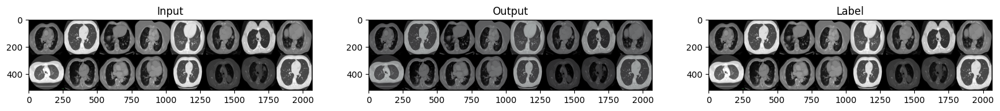


  4%|▎         | 1/27 [00:07<03:22,  7.80s/it]

Train Epoch: 19 [0/418 (0%)]	Loss: 0.714490


 41%|████      | 11/27 [00:21<00:22,  1.43s/it]

Train Epoch: 19 [20/418 (37%)]	Loss: 0.351080


 78%|███████▊  | 21/27 [00:35<00:08,  1.40s/it]

Train Epoch: 19 [40/418 (74%)]	Loss: 0.444112


100%|██████████| 27/27 [00:43<00:00,  1.62s/it]


Mean loss on trainset: 18.55638164281845



  0%|          | 0/195 [00:00<?, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


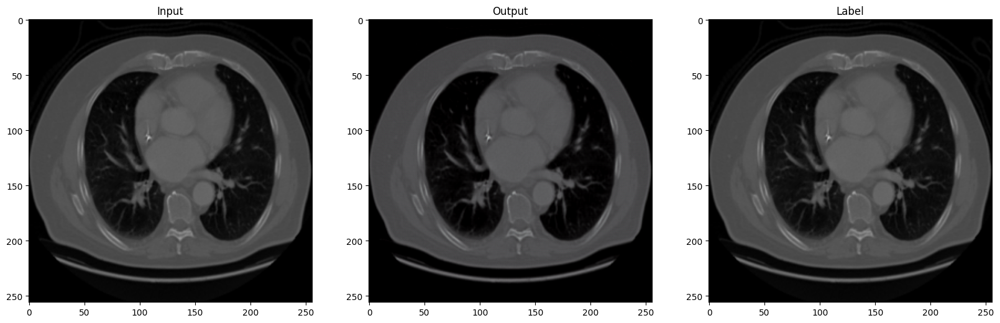


  1%|          | 1/195 [00:01<04:23,  1.36s/it]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Test Epoch: 19 [0/195 (0%)]	Loss: 0.649980


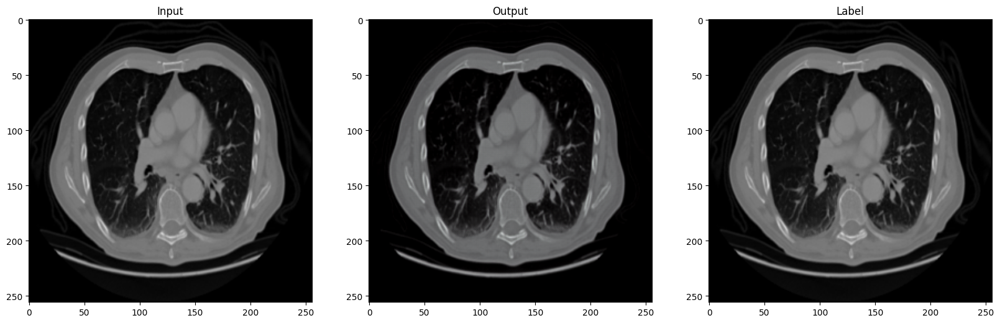


  1%|          | 2/195 [00:02<03:59,  1.24s/it]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


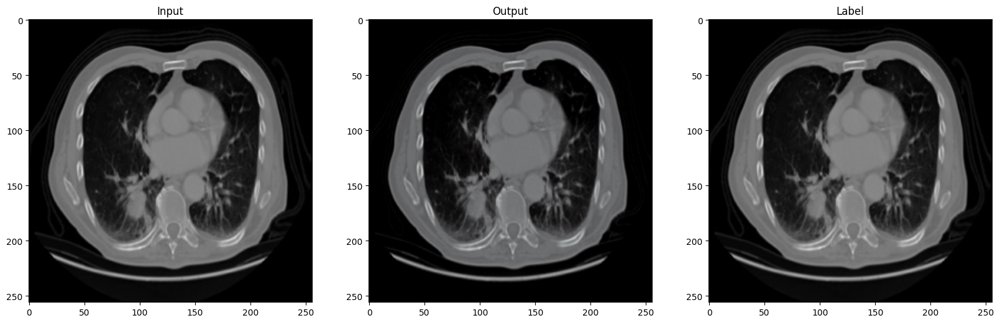

  8%|▊         | 15/195 [00:04<00:20,  8.77it/s]

Test Epoch: 19 [20/195 (5%)]	Loss: 0.555609


 13%|█▎        | 25/195 [00:04<00:10, 16.57it/s]

Test Epoch: 19 [40/195 (10%)]	Loss: 0.561613


 17%|█▋        | 34/195 [00:04<00:07, 21.13it/s]

Test Epoch: 19 [60/195 (15%)]	Loss: 0.684918


 24%|██▎       | 46/195 [00:05<00:06, 23.21it/s]

Test Epoch: 19 [80/195 (21%)]	Loss: 0.623282


 28%|██▊       | 55/195 [00:05<00:05, 24.33it/s]

Test Epoch: 19 [100/195 (26%)]	Loss: 0.594431


 33%|███▎      | 65/195 [00:06<00:05, 24.67it/s]

Test Epoch: 19 [120/195 (31%)]	Loss: 0.539178


 38%|███▊      | 74/195 [00:06<00:04, 24.73it/s]

Test Epoch: 19 [140/195 (36%)]	Loss: 0.528417


 44%|████▍     | 86/195 [00:07<00:04, 24.45it/s]

Test Epoch: 19 [160/195 (41%)]	Loss: 0.556837


 49%|████▊     | 95/195 [00:07<00:04, 24.47it/s]

Test Epoch: 19 [180/195 (46%)]	Loss: 0.582385


 54%|█████▍    | 105/195 [00:07<00:03, 24.94it/s]

Test Epoch: 19 [200/195 (51%)]	Loss: 0.522614


 58%|█████▊    | 114/195 [00:08<00:03, 24.70it/s]

Test Epoch: 19 [220/195 (56%)]	Loss: 0.512057


 65%|██████▍   | 126/195 [00:08<00:02, 24.57it/s]

Test Epoch: 19 [240/195 (62%)]	Loss: 0.540169


 69%|██████▉   | 135/195 [00:09<00:02, 24.43it/s]

Test Epoch: 19 [260/195 (67%)]	Loss: 0.450467


 74%|███████▍  | 144/195 [00:09<00:02, 24.08it/s]

Test Epoch: 19 [280/195 (72%)]	Loss: 0.584813


 80%|████████  | 156/195 [00:09<00:01, 24.01it/s]

Test Epoch: 19 [300/195 (77%)]	Loss: 0.794552


 85%|████████▍ | 165/195 [00:10<00:01, 23.90it/s]

Test Epoch: 19 [320/195 (82%)]	Loss: 0.942262


 89%|████████▉ | 174/195 [00:10<00:00, 23.86it/s]

Test Epoch: 19 [340/195 (87%)]	Loss: 0.634332


 94%|█████████▍| 183/195 [00:11<00:00, 23.04it/s]

Test Epoch: 19 [360/195 (92%)]	Loss: 0.479071


100%|██████████| 195/195 [00:11<00:00, 16.74it/s]

Test Epoch: 19 [380/195 (97%)]	Loss: 1.168420
Test loss: 119.95346069335938
Saving current model at /content/drive/MyDrive/Super_Resolution_DL2020/Python/checkpoints/checkpoints_22112023_191747_current.pth


In [8]:
from runet.main import train_runet
import torch
torch.cuda.empty_cache()

train_runet(img_size=64, train_bs=16, test_bs=1, lr=0.001)

/content/drive/MyDrive/CTScan_dataset/Data/train/Adenocarcinoma
/content/drive/MyDrive/CTScan_dataset/Data/train/Large cell carcinoma
/content/drive/MyDrive/CTScan_dataset/Data/train/Squamous cell carcinoma
/content/drive/MyDrive/CTScan_dataset/Data/train/Normal
Number of images found: 418
/content/drive/MyDrive/CTScan_dataset/Data/test/Adenocarcinoma
/content/drive/MyDrive/CTScan_dataset/Data/test/Large cell carcinoma
/content/drive/MyDrive/CTScan_dataset/Data/test/Squamous cell carcinoma
/content/drive/MyDrive/CTScan_dataset/Data/test/Normal
Number of images found: 195
Loading RUNet weights from checkpoints/checkpoints_22112023_191747_best.pth


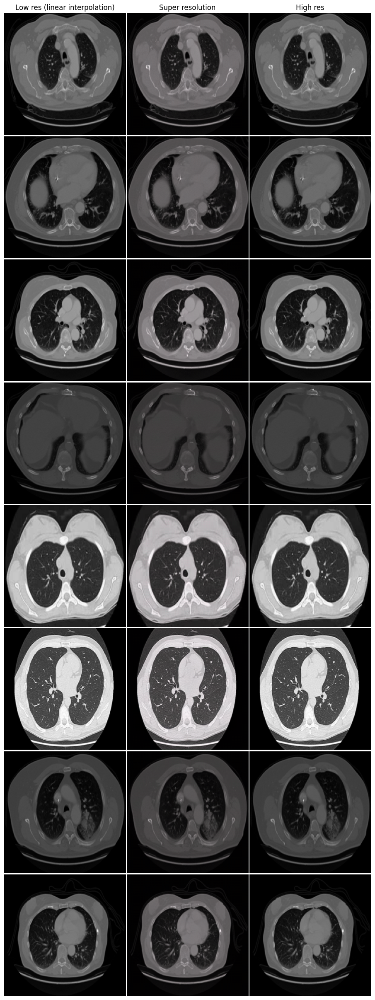

In [9]:
from runet.visualize import RUNetVisualizer

checkpoint_unet = "checkpoints/checkpoints_22112023_191747_best.pth"

visualizer_runet = RUNetVisualizer()
visualizer_runet.visualize_runet(checkpoint_unet, batch_size=8)

In [10]:
from runet.evaluate import RUNetEvaluation

checkpoint_unet = "checkpoints/checkpoints_22112023_191747_best.pth"
evaluator_runet = RUNetEvaluation()
evaluator_runet.evaluate(checkpoint_unet)

/content/drive/MyDrive/CTScan_dataset/Data/train/Adenocarcinoma
/content/drive/MyDrive/CTScan_dataset/Data/train/Large cell carcinoma
/content/drive/MyDrive/CTScan_dataset/Data/train/Squamous cell carcinoma
/content/drive/MyDrive/CTScan_dataset/Data/train/Normal
Number of images found: 418
/content/drive/MyDrive/CTScan_dataset/Data/test/Adenocarcinoma
/content/drive/MyDrive/CTScan_dataset/Data/test/Large cell carcinoma
/content/drive/MyDrive/CTScan_dataset/Data/test/Squamous cell carcinoma
/content/drive/MyDrive/CTScan_dataset/Data/test/Normal
Number of images found: 195
Loading RUNet weights from checkpoints/checkpoints_22112023_191747_best.pth


100%|██████████| 195/195 [00:09<00:00, 20.07it/s]

Mean PSNR of 38.642 on test set with std of 4.232
Mean SSIM of 0.99851 on test set with std of 0.00130
Mean MSE of 0.0002568 on test set with std of 0.0003777
Mean VGG-Perceptual of 0.15616 on test set with std of 0.10296


In [14]:
!cd /content/drive/MyDrive/Colab_Notebooks/Github

In [15]:
!git clone https://github.com/euijae/nyu_computer_vision_project

Cloning into 'nyu_computer_vision_project'...
fatal: could not read Username for 'https://github.com': No such device or address
